In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns
%matplotlib inline

In [2]:
df = pd.read_csv('../data/organized_uber.csv', parse_dates=['record_time'])
df.set_index('record_time', inplace=True)
df.index = df.index - pd.Timedelta(hours=7)
df['hour'] = df.index.hour
df['dayofmonth'] = df.index.day
df['date'] = df.index.date
df['dayofweek'] = df.index.dayofweek
df['weekofyear'] = df.index.weekofyear

### What is the changes in average price for uberX in all cities over time? (For a ride from downtown to airport) - Resampled by hour

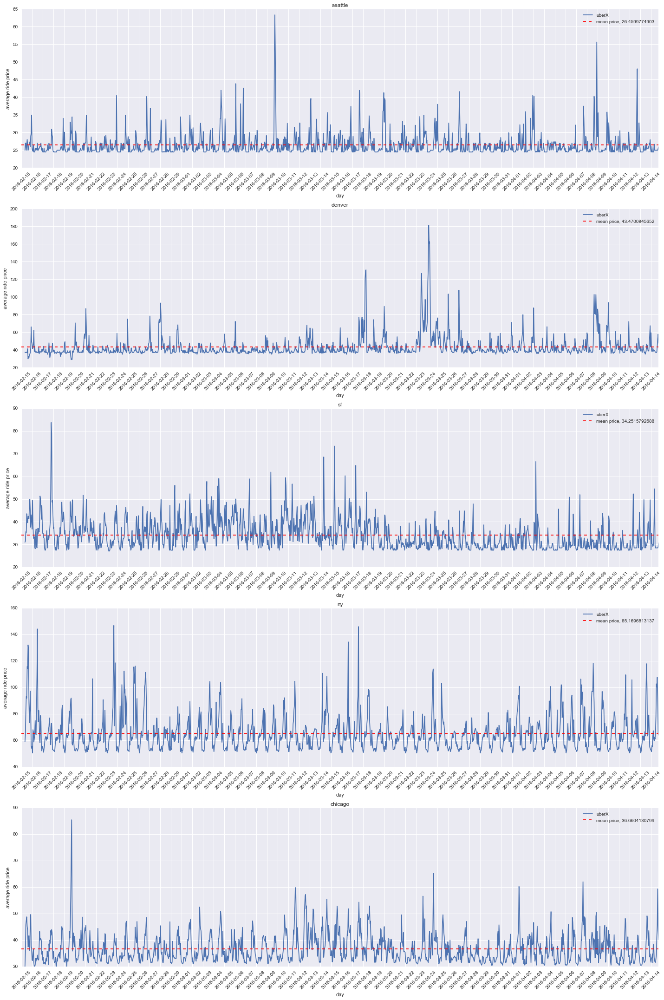

In [19]:
cities = df['city'].unique().tolist()
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['avg_price_est']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    data = df.query("display_name == 'uberX' and city == @cities[@i]")['avg_price_est'].resample('H').mean()
    mean_price = data.mean()
    axs.plot(data, label='uberX')
    axs.axhline(mean_price, color='r', ls='--', label='mean price, {}'.format(mean_price))
    axs.set_title(cities[i])
    axs.set_ylabel('average ride price')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.legend(loc='upper right')
plt.tight_layout()

1. The data appears to be relatively stationary (no trends), however, there are differences in average price for a ride between cities
2. There is obvious daily seasonality patterns

### What is variance in price with a time difference of d(t) = y_t - y_t-1 ? (Hourly Seasonality Effects)

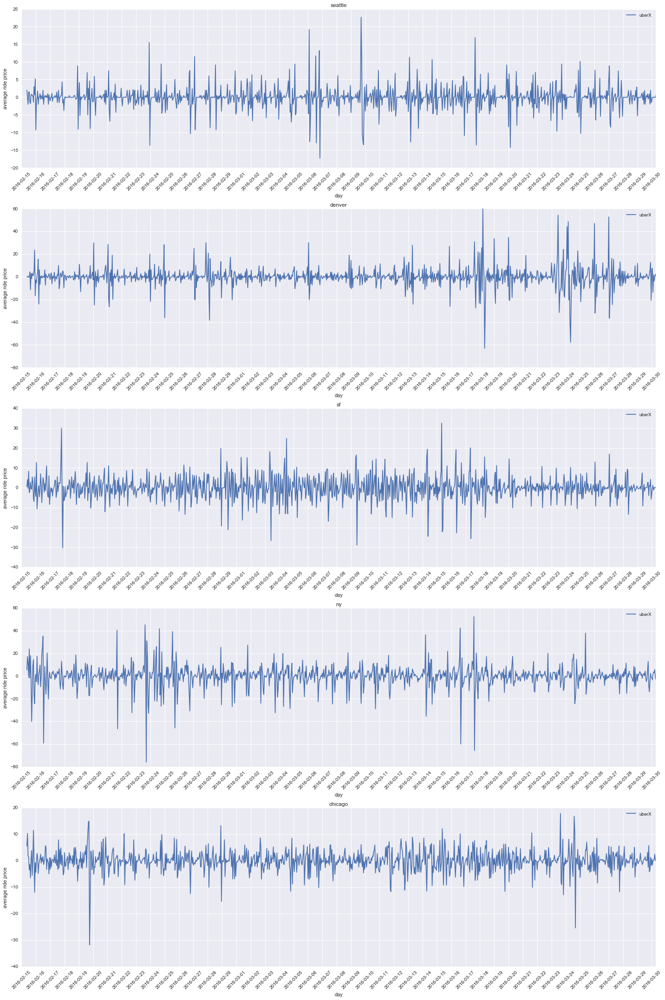

In [762]:
cities = df['city'].unique().tolist()
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['avg_price_est']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    data = df.query("display_name == 'uberX' and city == @cities[@i]")['avg_price_est'].resample('H')
    mean_price = data.mean()
    axs.plot(data.diff(periods=1), label='uberX')
    axs.set_title(cities[i])
    axs.set_ylabel('average ride price')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.legend(loc='upper right')
plt.tight_layout()

### Daily Seasonality Effects (d(t) = y_t - y_t-24

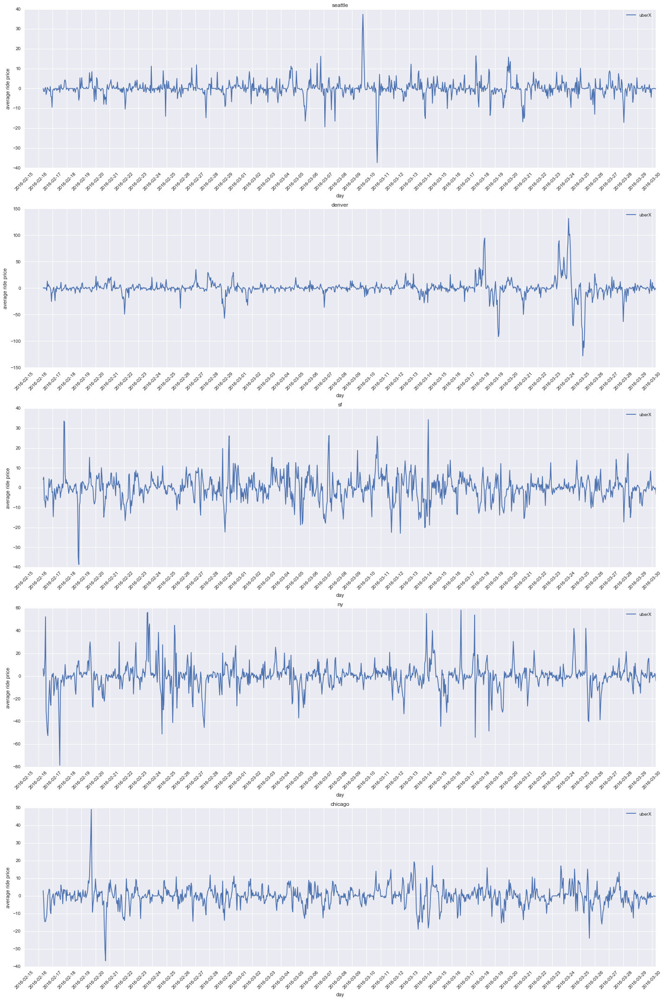

In [764]:
cities = df['city'].unique().tolist()
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['avg_price_est']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    data = df.query("display_name == 'uberX' and city == @cities[@i]")['avg_price_est'].resample('H')
    mean_price = data.mean()
    axs.plot(data.diff(periods=24), label='uberX')
    axs.set_title(cities[i])
    axs.set_ylabel('average ride price')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.legend(loc='upper right')
plt.tight_layout()

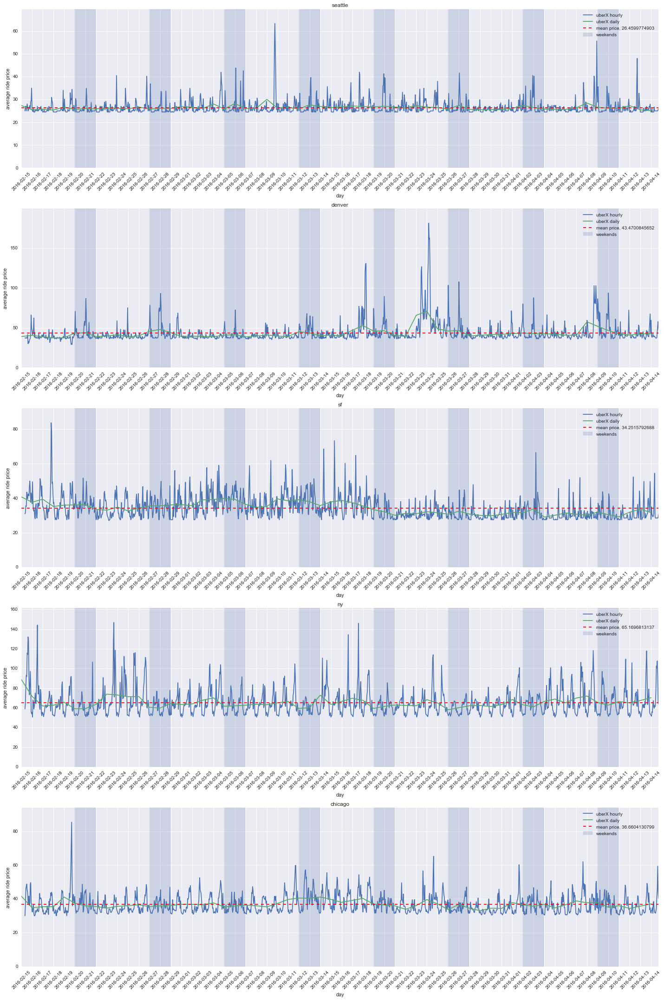

In [4]:
cities = df['city'].unique().tolist()
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['avg_price_est']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    daily = df.query("display_name == 'uberX' and city == @cities[@i]")['avg_price_est'].resample('D').mean()
    hourly = df.query("display_name == 'uberX' and city == @cities[@i]")[['avg_price_est','dayofweek']].resample('H').mean()
    mean_price = hourly['avg_price_est'].mean()
    axs.plot(hourly['avg_price_est'], label='uberX hourly')
    axs.fill_between(hourly.index, 0, hourly['avg_price_est'].max()*1.1, where=hourly['dayofweek'] >= 5, alpha=0.2, label='weekends')
    axs.plot(daily, label='uberX daily')
    axs.axhline(mean_price, color='r', ls='--', label='mean price, {}'.format(mean_price))
    axs.set_title(cities[i])
    axs.set_ylabel('average ride price')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.set_ylim([0,hourly['avg_price_est'].max()*1.1])
    axs.legend(loc='upper right')
plt.tight_layout()

### What is the seasonal decomposition of the prices in the cities for uberX? (Trend, Seasonal, Residual Factors)

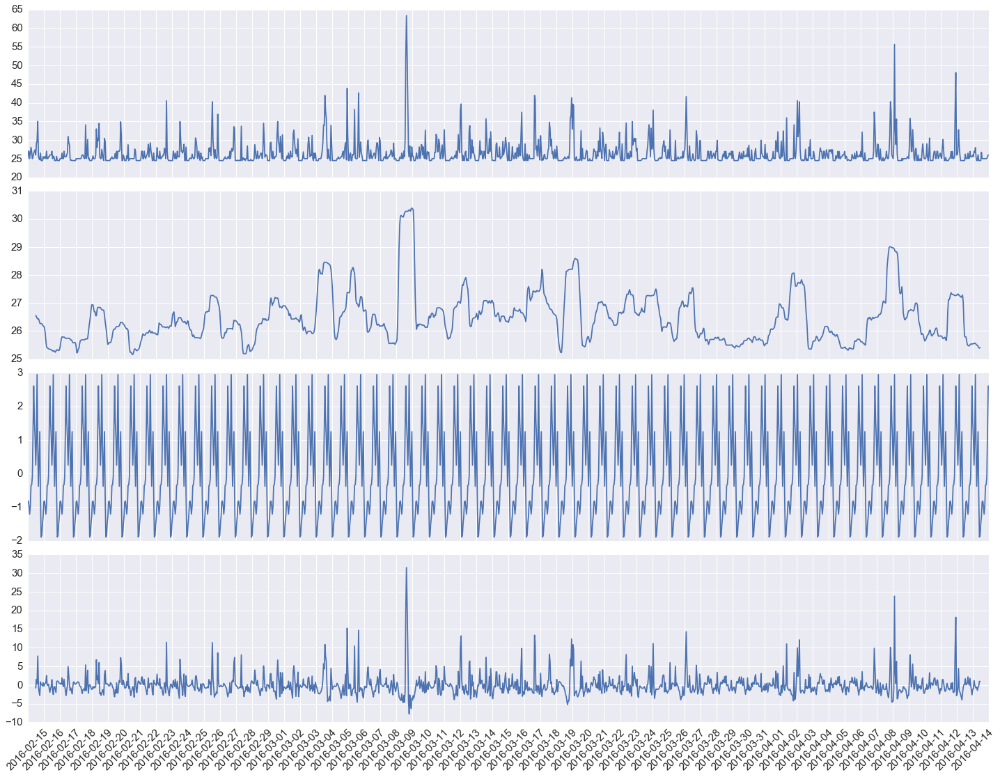

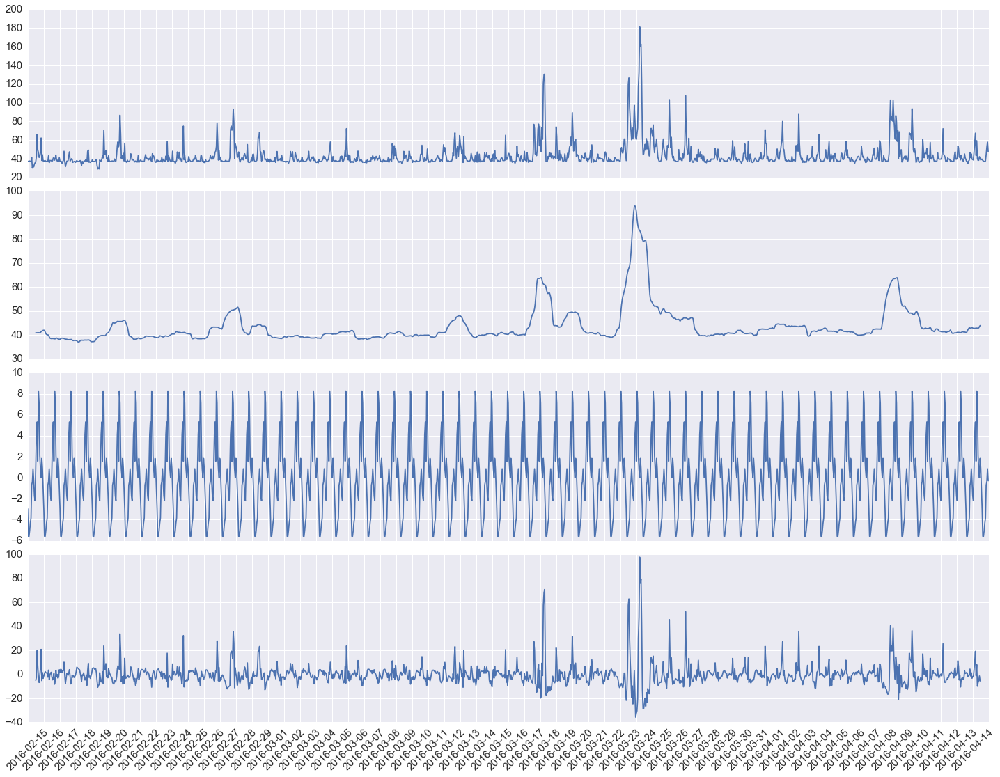

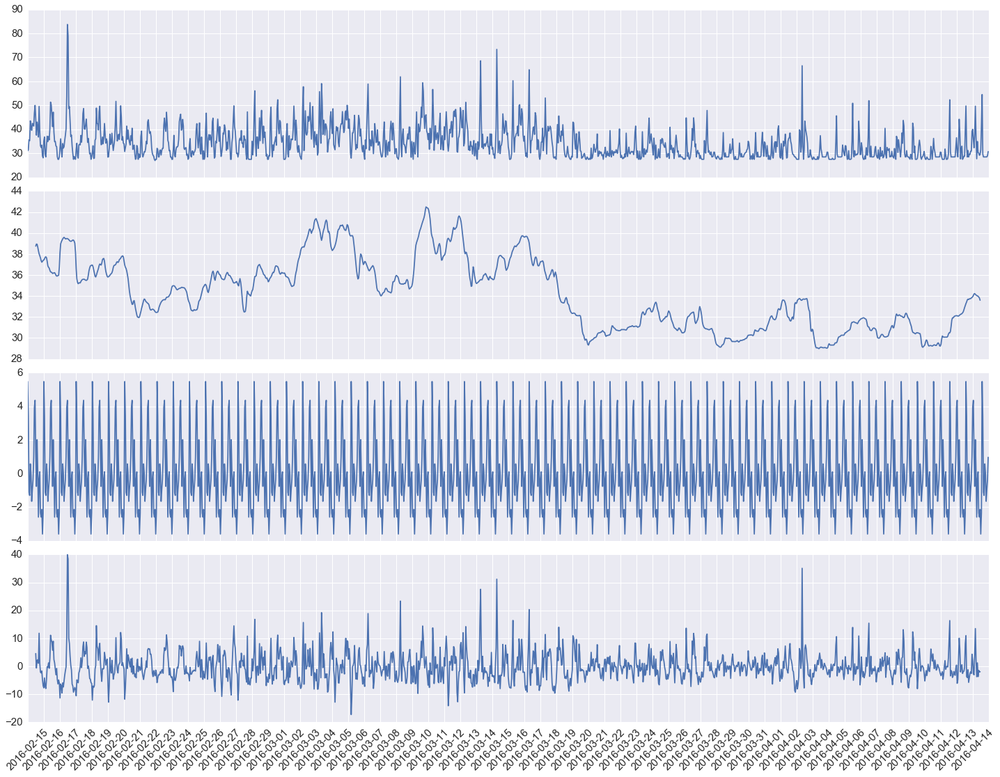

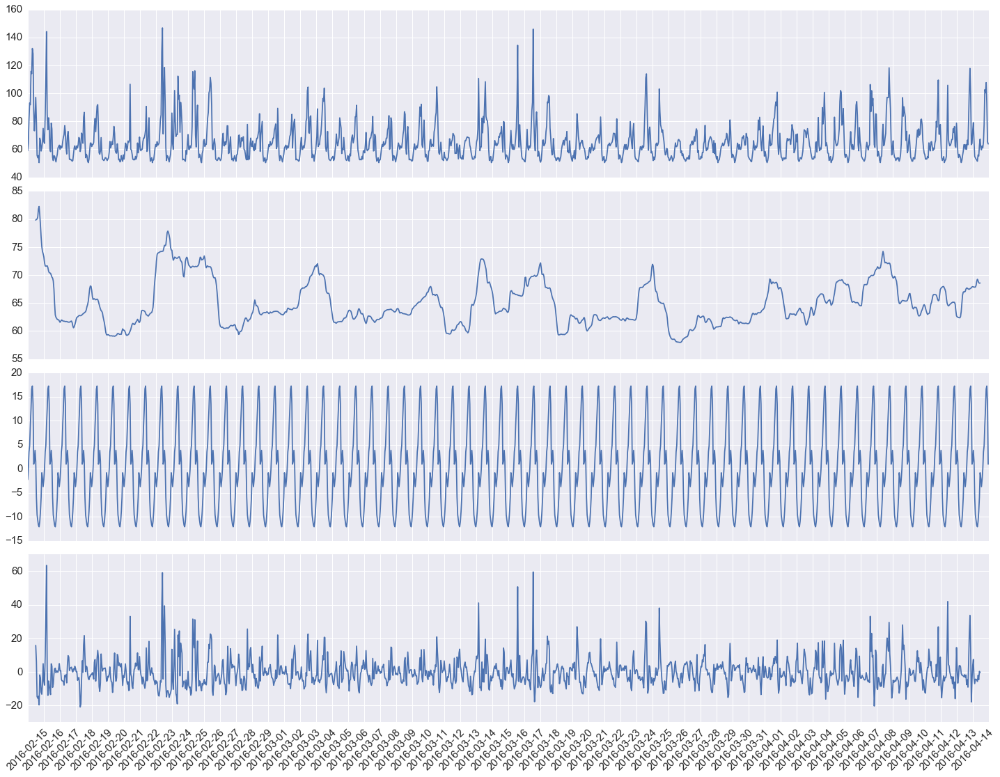

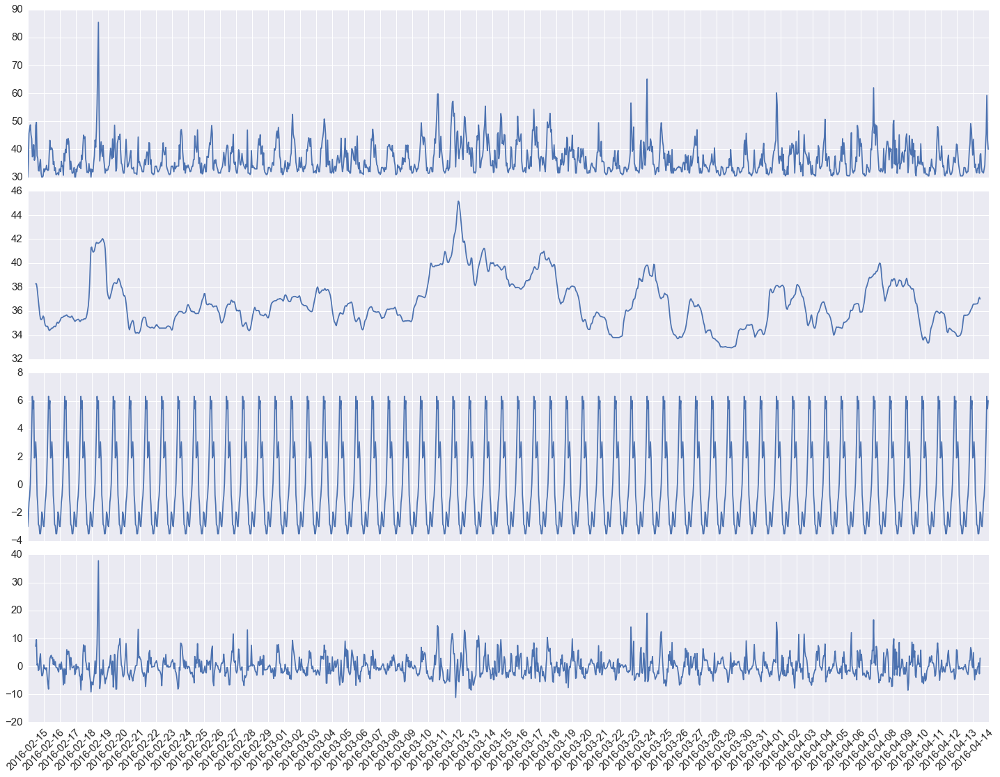

In [8]:
import statsmodels.api as sm

d_hr = d.resample('H').mean()
d_dates = np.unique(d_hr.index.date)
for city in cities:
    hourly = df.query("display_name == 'uberX' and city == @city").resample('H').mean()
    decomposition = sm.tsa.seasonal_decompose(hourly['avg_price_est'].values, model='additive', freq=24)  
    fig = decomposition.plot()
    fig.set_figheight(15)
    fig.set_figwidth(20)
    fig.tight_layout()
    axs_f = fig.get_axes()[0]
    axs_l = fig.get_axes()[-1]
    start, end = axs_l.get_xlim()
    stepsize=end/d_dates.shape[0]
    axs_l.xaxis.set_ticks(np.arange(start, end, stepsize))
    axs_l.set_xticklabels(d_dates, rotation='45', fontsize=15)
    axs_l.set_xlabel("", fontsize=20)
#     axs_f.set_title(city.capitalize() + " UberX Data Decomposition From 2-15-16 to 4-14-16", fontsize=30);
    axs_a = fig.get_axes()
    labels = ['Observed Prices','Trend','Seasonal','Residual']
    for i, ax in enumerate(axs_a):
        ax.tick_params(labelsize=15)
        ax.set_ylabel('', fontsize=20)

In [768]:
df.columns

Index([u'city', u'display_name', u'price_estimate', u'low_estimate',
       u'avg_price_est', u'high_estimate', u'trip_duration', u'trip_distance',
       u'surge_multiplier', u'surge_minimum_price', u'pickup_estimate',
       u'capacity', u'base_price', u'base_minimum_price', u'cost_per_minute',
       u'cost_per_distance', u'distance_unit', u'cancellation_fee',
       u'currency_code', u'service_fees', u'service_fees_type', u'image',
       u'description', u'start_latitude', u'start_longitude', u'stop_latitude',
       u'stop_longitude', u'start_address', u'stop_address', u'product_id',
       u'hour', u'day', u'date', u'dayofweek'],
      dtype='object')

### Which features are highly correlated with each other? (which features need future investigation or need to be eliminated?)

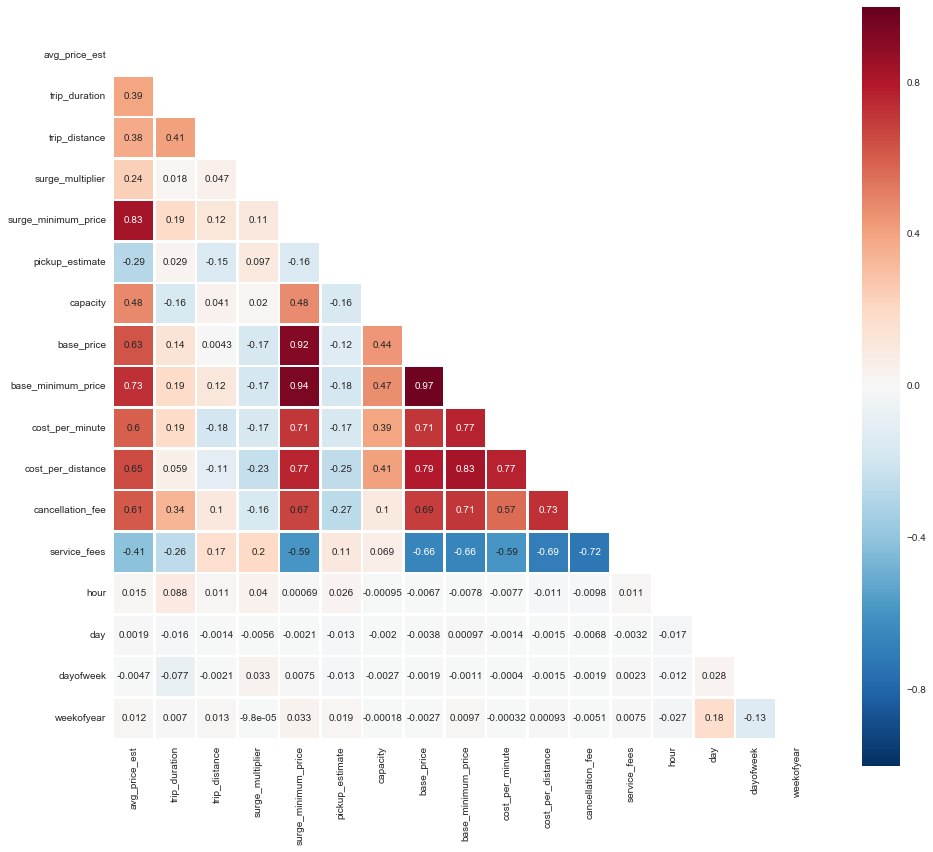

In [772]:
features = ['avg_price_est','trip_duration','trip_distance',
            'surge_multiplier','surge_minimum_price','pickup_estimate',
            'capacity','base_price','base_minimum_price','cost_per_minute',
            'cost_per_distance','cancellation_fee','service_fees','hour','day',
           'date','dayofweek','weekofyear']
fs = df[features].corr()
mask = np.zeros_like(fs)
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(14,12))
with sns.axes_style("white"):
    sns.heatmap(fs, mask=mask, square=True, annot=True, linewidths=1.5)
plt.yticks(rotation=0)
plt.xticks(rotation=90)
plt.tight_layout();

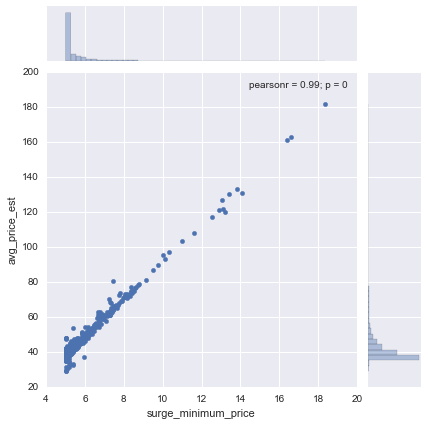

In [773]:
c = df.query("display_name == 'uberX' and city == 'denver'")[['surge_minimum_price','avg_price_est']].resample('H')
sns.jointplot(x="surge_minimum_price", y="avg_price_est", data=c);

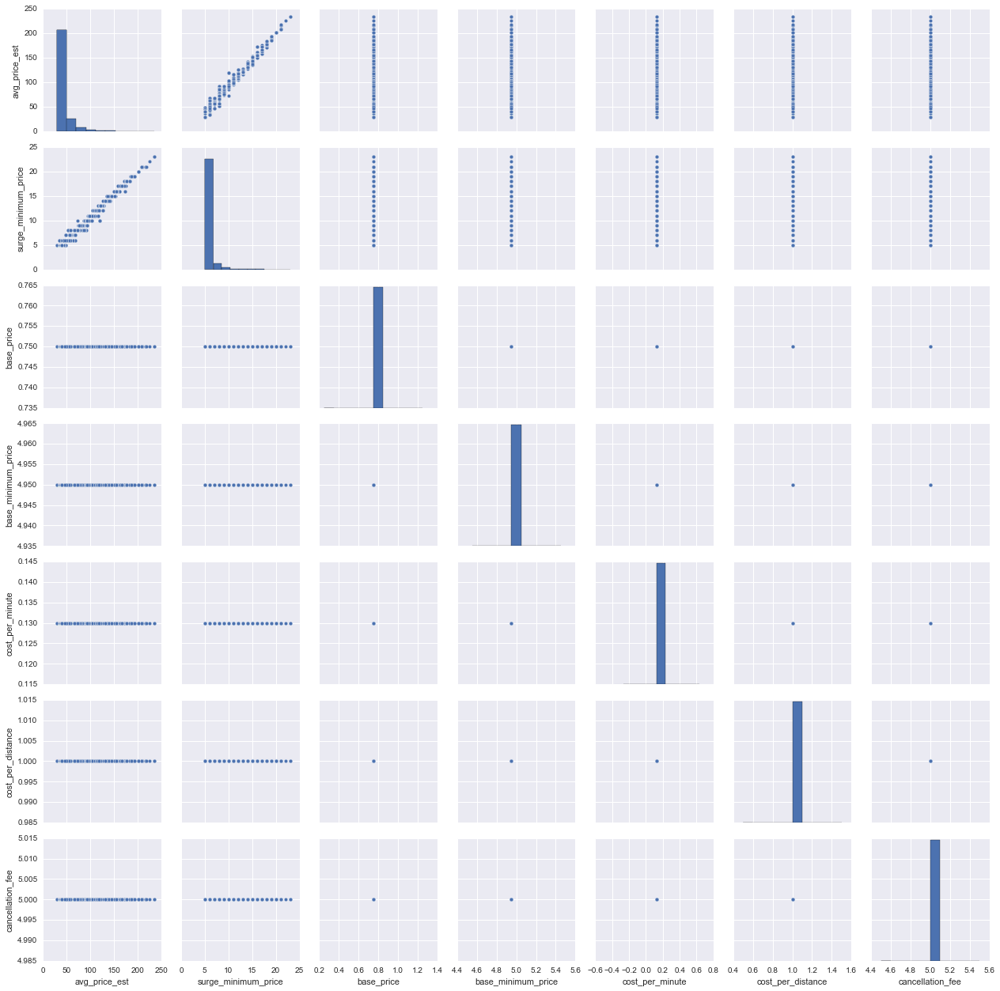

In [252]:
sub_features = ['avg_price_est','surge_minimum_price','base_price',
                'base_minimum_price','cost_per_minute','cost_per_distance',
               'cancellation_fee']
scmat = df.query("display_name == 'uberX' and city == 'denver'")[sub_features]
sns.pairplot(scmat);

### What is the differences in prices of each car type (uberX, uberXL, uberBLACK, uberSUV) for all cities over time? 

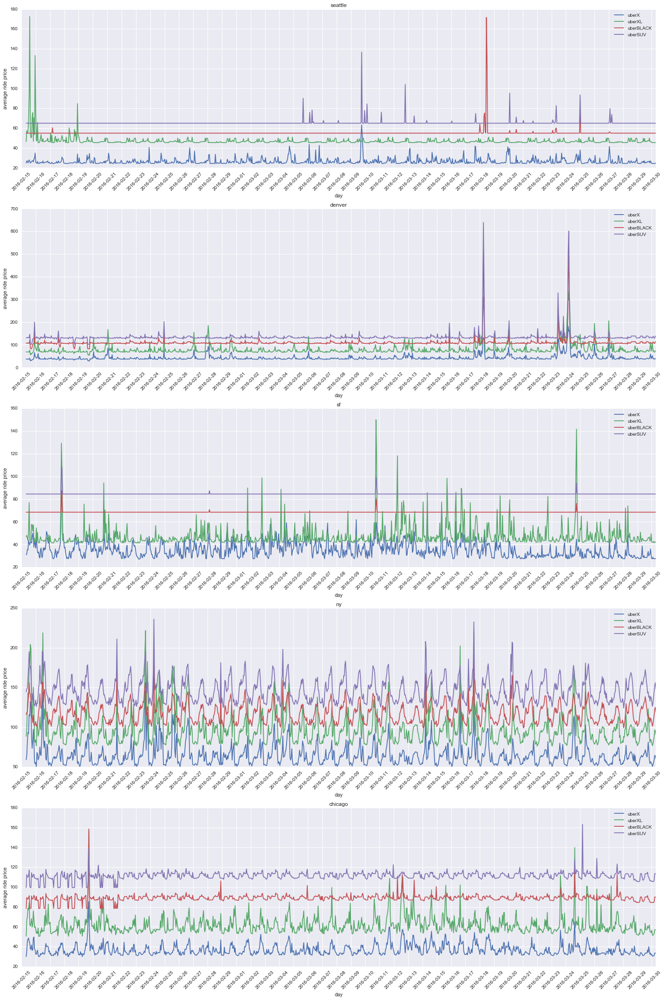

In [774]:
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['avg_price_est']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    for cartype in cartypes:
        data = df.query("display_name == @cartype and city == @cities[@i]")['avg_price_est'].resample('H')
        axs.plot(data, label=cartype)
    axs.set_title(cities[i])
    axs.set_ylabel('average ride price')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.legend(loc='upper right')
plt.tight_layout()

### What is the weekly changes in ride prices in all cities? Where are the outliers?

In [696]:
agg_wkly_dates.values()

['2016-02-22\n2016-02-29\n2016-03-07\n2016-03-14\n2016-03-21\n',
 '2016-02-23\n2016-03-01\n2016-03-08\n2016-03-15\n2016-03-22\n',
 '2016-02-24\n2016-03-02\n2016-03-09\n2016-03-16\n2016-03-23\n',
 '2016-02-25\n2016-03-03\n2016-03-10\n2016-03-17\n2016-03-24\n',
 '2016-02-26\n2016-03-04\n2016-03-11\n2016-03-18\n2016-03-25\n',
 '2016-02-27\n2016-03-05\n2016-03-12\n2016-03-19\n2016-03-26\n',
 '2016-02-28\n2016-03-06\n2016-03-13\n2016-03-20\n2016-03-27\n']

In [19]:
df.columns

Index([u'city', u'display_name', u'price_estimate', u'low_estimate',
       u'avg_price_est', u'high_estimate', u'trip_duration', u'trip_distance',
       u'surge_multiplier', u'surge_minimum_price', u'pickup_estimate',
       u'capacity', u'base_price', u'base_minimum_price', u'cost_per_minute',
       u'cost_per_distance', u'distance_unit', u'cancellation_fee',
       u'currency_code', u'service_fees', u'service_fees_type', u'image',
       u'description', u'start_latitude', u'start_longitude', u'stop_latitude',
       u'stop_longitude', u'start_address', u'stop_address', u'product_id',
       u'hour', u'day', u'date', u'dayofweek', u'weekofyear'],
      dtype='object')

[datetime.date(2016, 2, 15) datetime.date(2016, 2, 22)
 datetime.date(2016, 2, 29) datetime.date(2016, 3, 7)
 datetime.date(2016, 3, 14) datetime.date(2016, 3, 21)
 datetime.date(2016, 3, 28) datetime.date(2016, 4, 4)
 datetime.date(2016, 4, 11)]


/Users/timhou/anaconda/envs/python2/lib/python2.7/site-packages/ipykernel/__main__.py:14: FutureWarning: .resample() is now a deferred operation
use .resample(...).mean() instead of .resample(...)


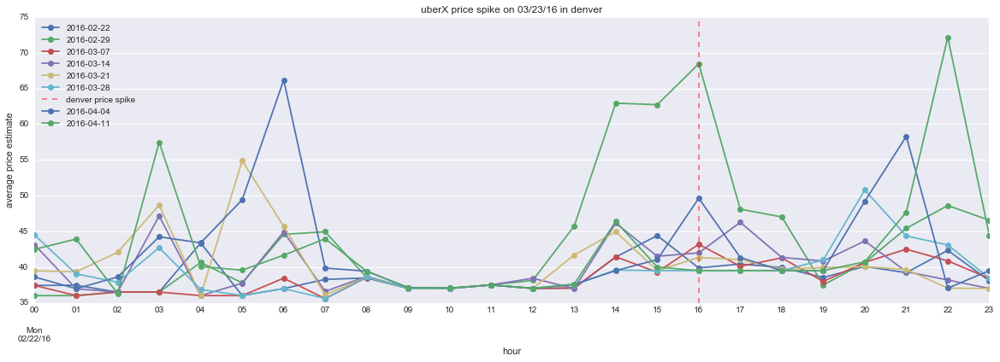

In [15]:
from matplotlib.dates import MonthLocator, WeekdayLocator, DateFormatter, HourLocator

city = 'denver'
cartype = 'uberX'
dayofweek = 0
dateofint = '03/23/16'
sdates = np.unique(df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].index.date)
sday = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(sdates[1])].resample('H')
print sdates
# print sday
fig, ax = plt.subplots(figsize=(20,6))
for i, date in enumerate(sdates[1:]):
    data = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(date)].resample('H')
    ax.plot_date(sday.index.to_pydatetime(), data.values, 'o-', label=date);
    ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
    ax.xaxis.set_minor_formatter(DateFormatter('%H'))
    ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
    ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
    ax.set_title('{} price spike on {} in {}'.format(cartype, dateofint, city))
    ax.set_ylabel('average price estimate')
    ax.set_xlabel('hour')
    if i == 5:
        ax.axvline(pd.to_datetime('2016-02-22 16:00:00'), color='r', ls='--', alpha=0.5, label='denver price spike')
    ax.legend(loc='best');

[datetime.date(2016, 2, 17) datetime.date(2016, 2, 24)
 datetime.date(2016, 3, 2) datetime.date(2016, 3, 9)
 datetime.date(2016, 3, 16) datetime.date(2016, 3, 23)
 datetime.date(2016, 3, 30) datetime.date(2016, 4, 6)
 datetime.date(2016, 4, 13)]


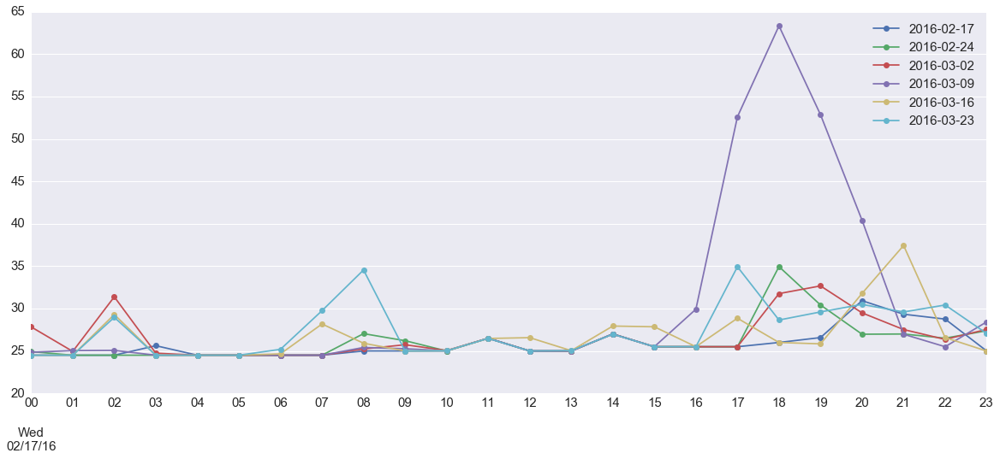

In [21]:
from matplotlib.dates import MonthLocator, WeekdayLocator, DateFormatter, HourLocator

sdates = np.unique(df.query("city == 'seattle' and display_name == 'uberX' and dayofweek == 2")['avg_price_est'].index.date)
sday = df.query("city == 'seattle' and display_name == 'uberX' and dayofweek == 2")['avg_price_est'].ix[str(sdates[0])].resample('H').mean()
print sdates
# print sday
fig, ax = plt.subplots(figsize=(20,8))
for i, date in enumerate(sdates[:-3]):
    data = df.query("city == 'seattle' and display_name == 'uberX' and dayofweek == 2")['avg_price_est'].ix[str(date)].resample('H').mean()
    ax.plot_date(sday.index.to_pydatetime(), data.values, 'o-', label=date);
    ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
    ax.xaxis.set_minor_formatter(DateFormatter('%H'))
    ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
    ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
#     ax.set_title('uberX price spike on 03/09/16 in seattle')
#     ax.set_ylabel('average price estimate')
#     ax.set_xlabel('hour')
    ax.tick_params(labelsize=15, which="both")
#     if i == 5:
#         ax.axvline(pd.to_datetime('2016-02-17 18:00:00'), color='r', ls='--', alpha=0.5, label='bieber concert at 7:30pm')
    ax.legend(loc='best', fontsize=15);

[datetime.date(2016, 2, 17) datetime.date(2016, 2, 24)
 datetime.date(2016, 3, 2) datetime.date(2016, 3, 9)
 datetime.date(2016, 3, 16) datetime.date(2016, 3, 23)
 datetime.date(2016, 3, 30)]


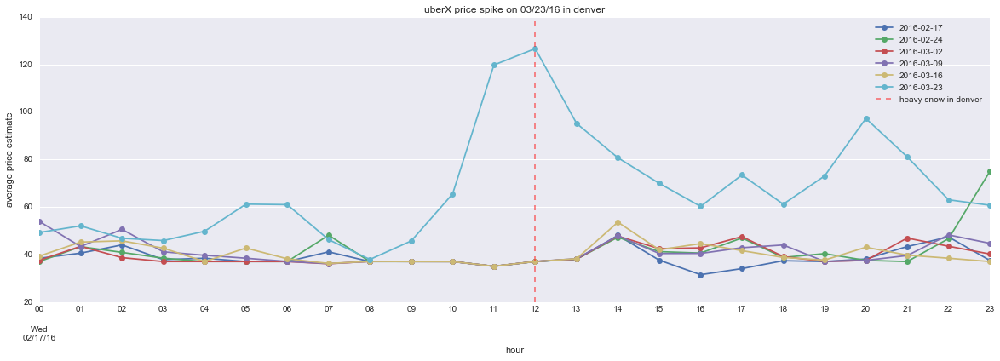

In [13]:
city = 'denver'
cartype = 'uberX'
dayofweek = 2
dateofint = '03/23/16'
sdates = np.unique(df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].index.date)
sday = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(sdates[0])].resample('H')
print sdates
# print sday
fig, ax = plt.subplots(figsize=(20,6))
for i, date in enumerate(sdates[:-1]):
    data = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(date)].resample('H')
    ax.plot_date(sday.index.to_pydatetime(), data.values, 'o-', label=date);
    ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
    ax.xaxis.set_minor_formatter(DateFormatter('%H'))
    ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
    ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
    ax.set_title('{} price spike on {} in {}'.format(cartype, dateofint, city))
    ax.set_ylabel('average price estimate')
    ax.set_xlabel('hour')
    if i == 5:
        ax.axvline(pd.to_datetime('2016-02-17 12:00:00'), color='r', ls='--', alpha=0.5, label='heavy snow in denver')
    ax.legend(loc='best');

[datetime.date(2016, 2, 19) datetime.date(2016, 2, 26)
 datetime.date(2016, 3, 4) datetime.date(2016, 3, 11)
 datetime.date(2016, 3, 18) datetime.date(2016, 3, 25)]


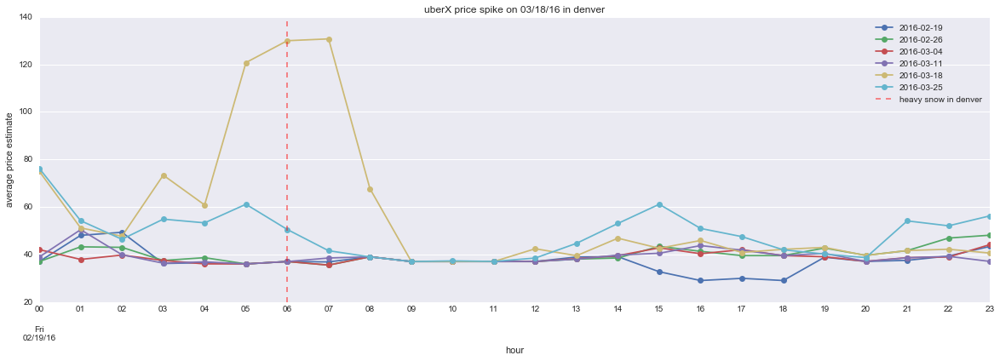

In [48]:
city = 'denver'
cartype = 'uberX'
dayofweek = 4
dateofint = '03/18/16'
sdates = np.unique(df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].index.date)
sday = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(sdates[0])].resample('H')
print sdates
# print sday
fig, ax = plt.subplots(figsize=(20,6))
for i, date in enumerate(sdates):
    data = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(date)].resample('H')
    ax.plot_date(sday.index.to_pydatetime(), data.values, 'o-', label=date);
    ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
    ax.xaxis.set_minor_formatter(DateFormatter('%H'))
    ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
    ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
    ax.set_title('{} price spike on {} in {}'.format(cartype, dateofint, city))
    ax.set_ylabel('average price estimate')
    ax.set_xlabel('hour')
    if i == 5:
        ax.axvline(pd.to_datetime('2016-02-19 06:00:00'), color='r', ls='--', alpha=0.5, label='heavy snow in denver')
    ax.legend(loc='best');

[datetime.date(2016, 2, 16) datetime.date(2016, 2, 23)
 datetime.date(2016, 3, 1) datetime.date(2016, 3, 8)
 datetime.date(2016, 3, 15) datetime.date(2016, 3, 22)
 datetime.date(2016, 3, 29)]


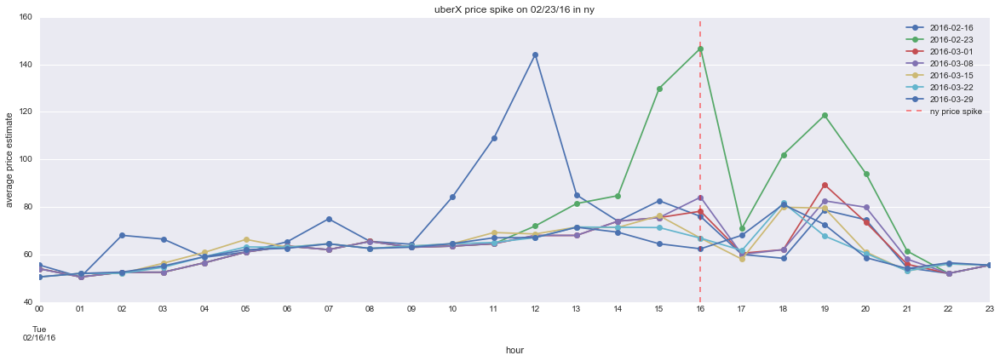

In [54]:
city = 'ny'
cartype = 'uberX'
dayofweek = 1
dateofint = '02/23/16'
sdates = np.unique(df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].index.date)
sday = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(sdates[0])].resample('H')
print sdates
# print sday
fig, ax = plt.subplots(figsize=(20,6))
for i, date in enumerate(sdates):
    data = df.query("city == @city and display_name == @cartype and dayofweek == @dayofweek")['avg_price_est'].ix[str(date)].resample('H')
    ax.plot_date(sday.index.to_pydatetime(), data.values, 'o-', label=date);
    ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
    ax.xaxis.set_minor_formatter(DateFormatter('%H'))
    ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
    ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
    ax.set_title('{} price spike on {} in {}'.format(cartype, dateofint, city))
    ax.set_ylabel('average price estimate')
    ax.set_xlabel('hour')
    if i == 6:
        ax.axvline(pd.to_datetime('2016-02-16 16:00:00'), color='r', ls='--', alpha=0.5, label='ny price spike')
    ax.legend(loc='best');

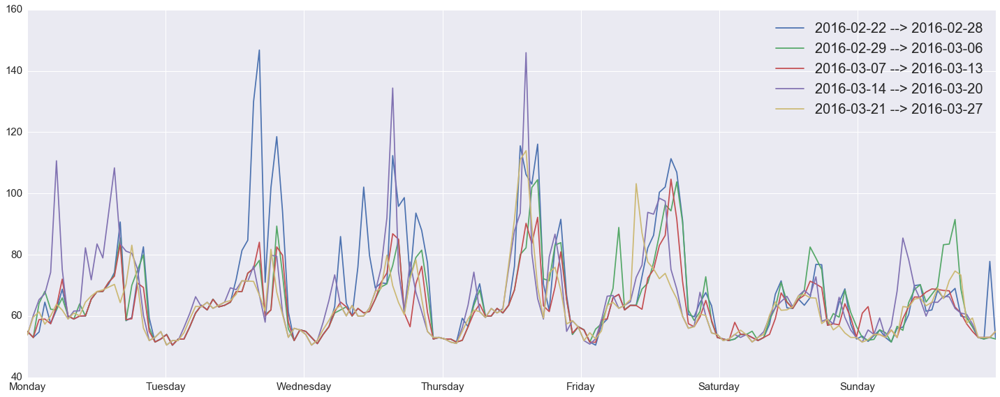

In [4]:
from collections import defaultdict

cities = df['city'].unique().tolist()
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
agg_wkly_dates = defaultdict(str)
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, axs = plt.subplots(figsize=(20,8))
for start, end in wkly_dates:
    data = df.query("city == @cities[3] and display_name == @cartypes[0]").ix[start:end].resample('H').mean()
    axs.plot(data.reset_index()['avg_price_est'], label='{} --> {}'.format(start,end))
    dates = np.unique(data.index.date)
#     for j,date in enumerate(dates):
#         if str(date) not in agg_wkly_dates[j]:
#             agg_wkly_dates[j] += str(date) + '\n'
#     axs.set_ylabel('Average Price Estimate', fontsize=20)
#     axs.set_xlabel('Time', fontsize=20)
    week_names = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
    axs.tick_params(labelsize=15)
    start, end = axs.get_xlim()
    stepsize = end / dates.shape[0]
    axs.set_xticks(np.arange(start, end, stepsize))
    axs.set_xticklabels(week_names)
    axs.legend(loc='upper right', fontsize=20)
#     axs.set_title("New York UberX Weekly Prices From 2-22-16 to 3-27-16", fontsize=30)
plt.tight_layout()

/Users/timhou/anaconda/envs/python2/lib/python2.7/site-packages/ipykernel/__main__.py:13: FutureWarning: .resample() is now a deferred operation
use .resample(...).mean() instead of .resample(...)
/Users/timhou/anaconda/envs/python2/lib/python2.7/site-packages/ipykernel/__main__.py:14: FutureWarning: .resample() is now a deferred operation
use .resample(...).mean() instead of .resample(...)


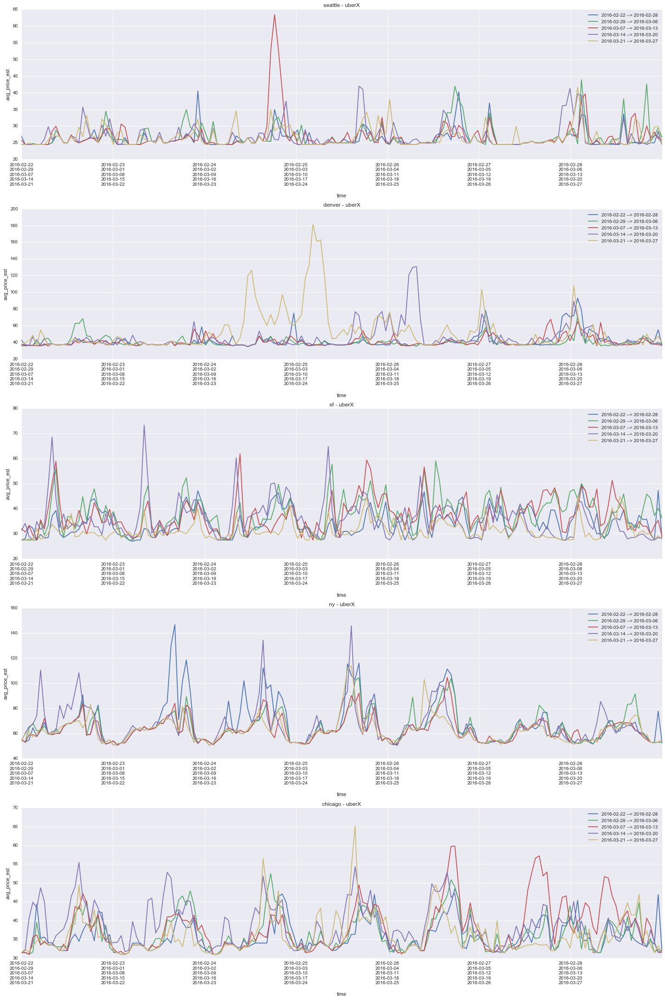

In [4]:
from collections import defaultdict

cities = df['city'].unique().tolist()
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
agg_wkly_dates = defaultdict(str)
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[å@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['avg_price_est'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        for j,date in enumerate(dates):
            if str(date) not in agg_wkly_dates[j]:
                agg_wkly_dates[j] += str(date) + '\n'
        axs.set_ylabel('avg_price_est')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(agg_wkly_dates.values())
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))
plt.tight_layout()

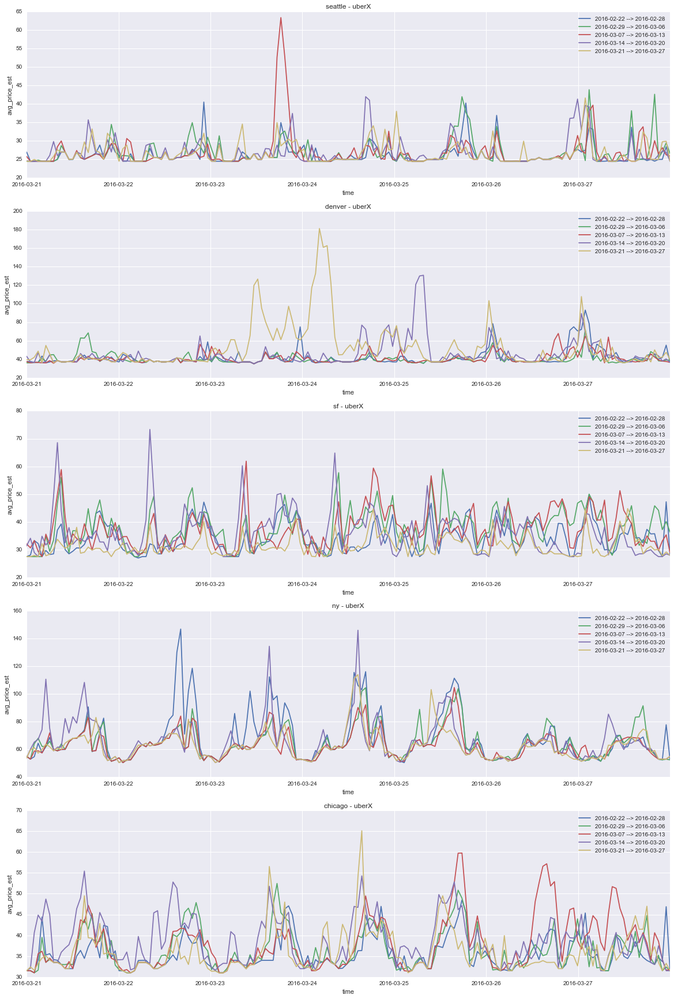

In [13]:
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['avg_price_est'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('avg_price_est')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))
#     if cities[i] == 'denver':
#         axs.axvline(pd.to_datetime('2016-03-24').date(), label='heavy snow', color='r', linestyle='--')

In [713]:
pd.to_datetime('2016-03-24').date()

datetime.date(2016, 3, 24)

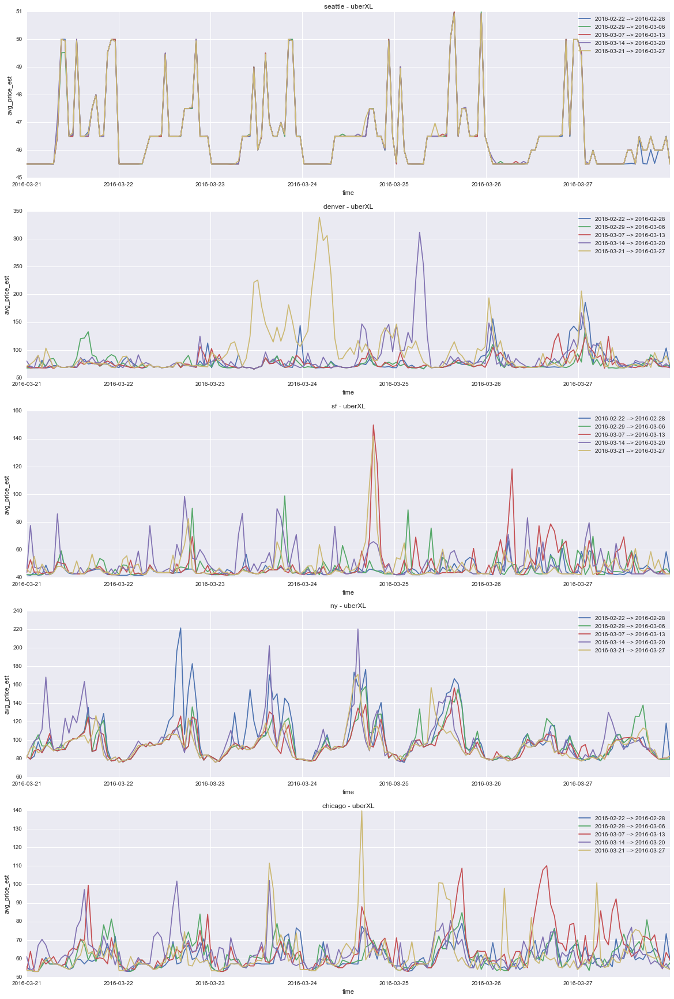

In [5]:
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[1]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['avg_price_est'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('avg_price_est')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[1]))

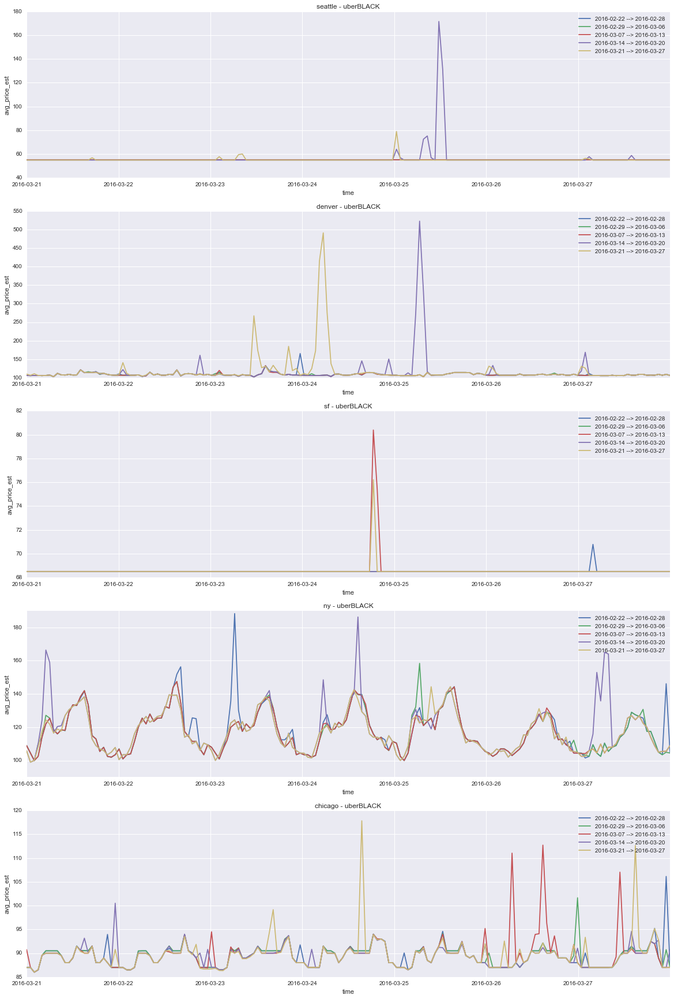

In [778]:
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[2]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['avg_price_est'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('avg_price_est')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[2]))

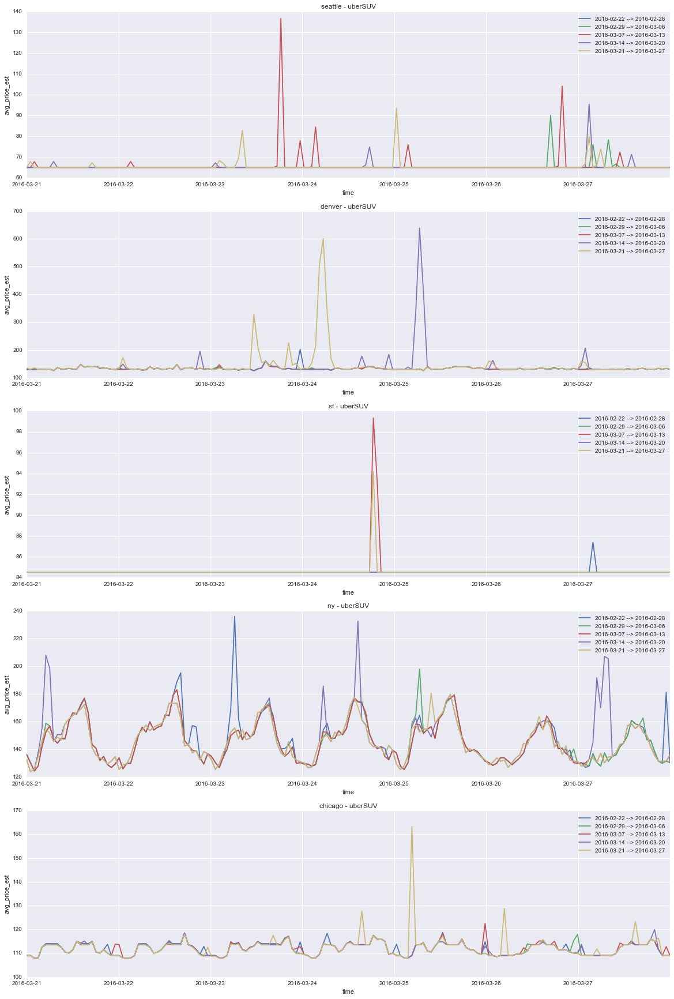

In [779]:
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[3]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['avg_price_est'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('avg_price_est')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[3]))

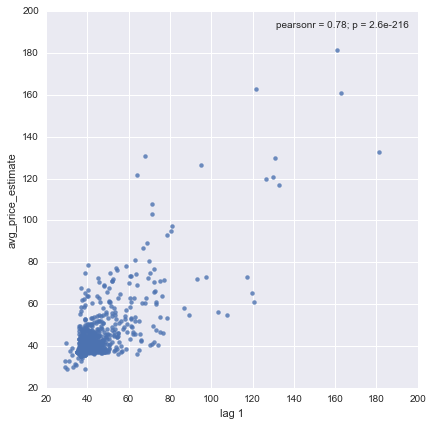

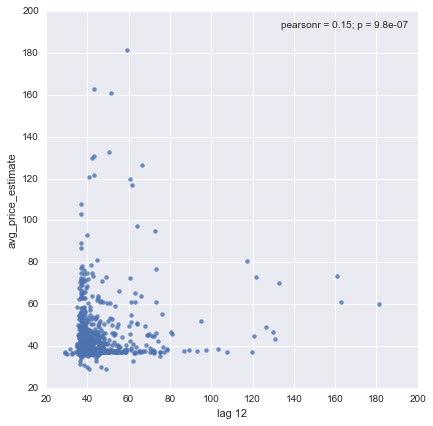

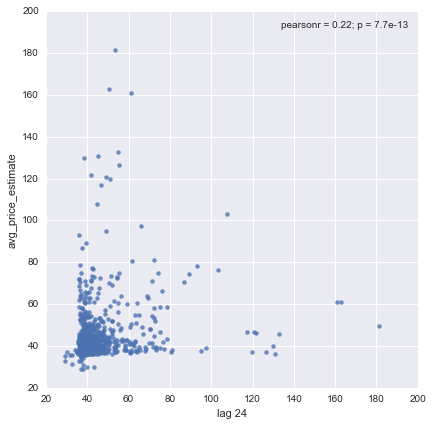

In [780]:
from scipy.stats import pearsonr

d = df.query("display_name == 'uberX' and city == 'denver'")['avg_price_est'].resample('H')
for lag in [1,12,24]:
    g = sns.JointGrid(d, d.shift(lag), ratio=100).set_axis_labels("lag {}".format(lag),"avg_price_estimate")
    g.plot_joint(sns.regplot, fit_reg=False)
    g.annotate(pearsonr)
    g.ax_marg_x.set_axis_off()
    g.ax_marg_y.set_axis_off();

### What is the autocorrelation/partial autocorrelation with lag of 48? (2 days) (for uberX)

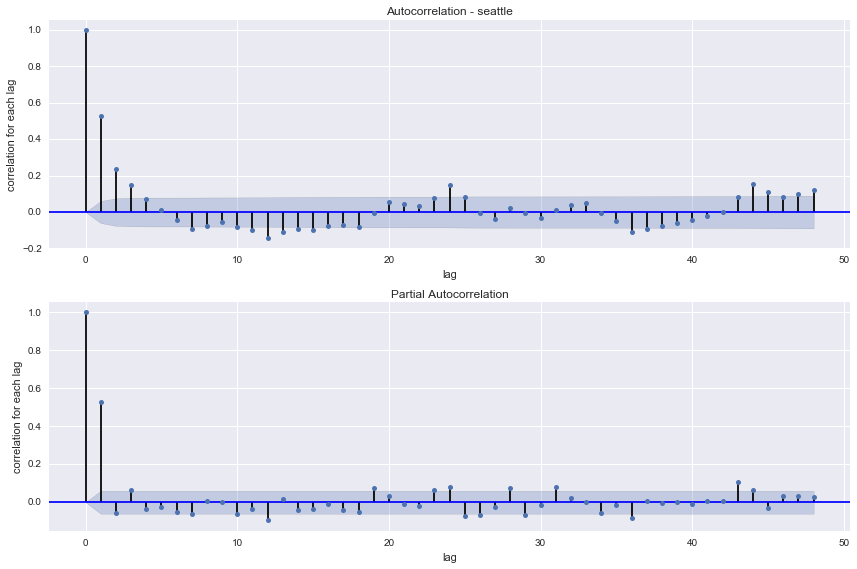

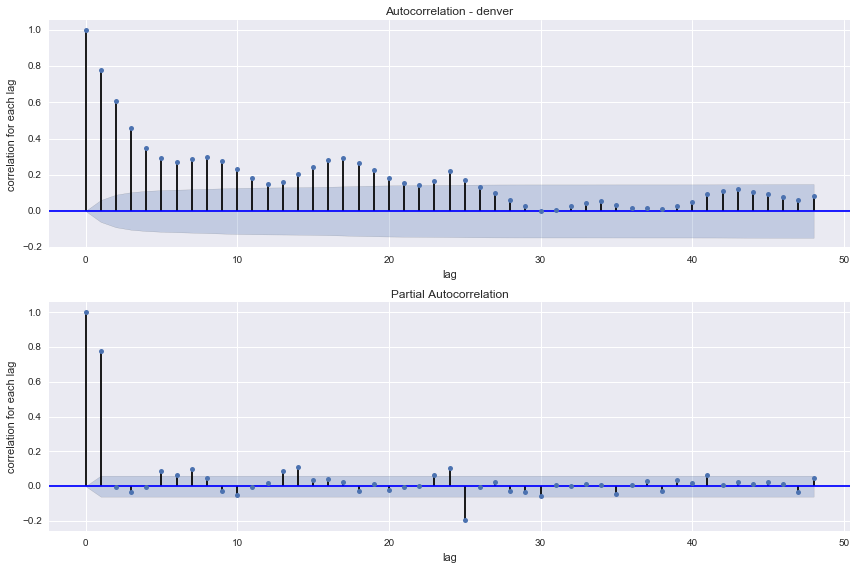

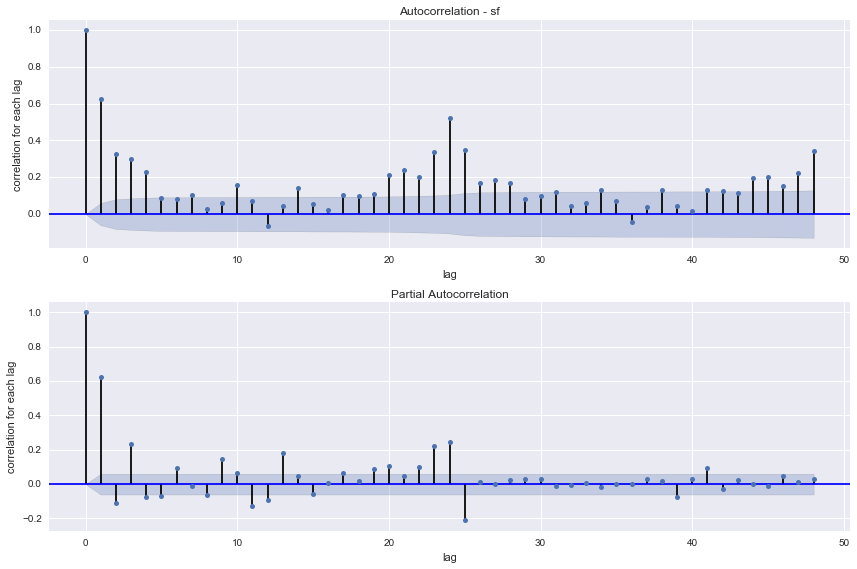

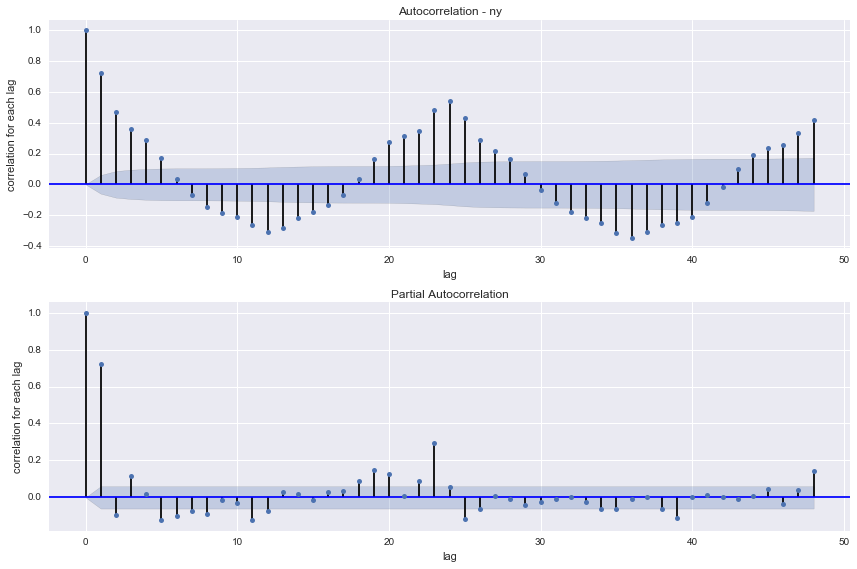

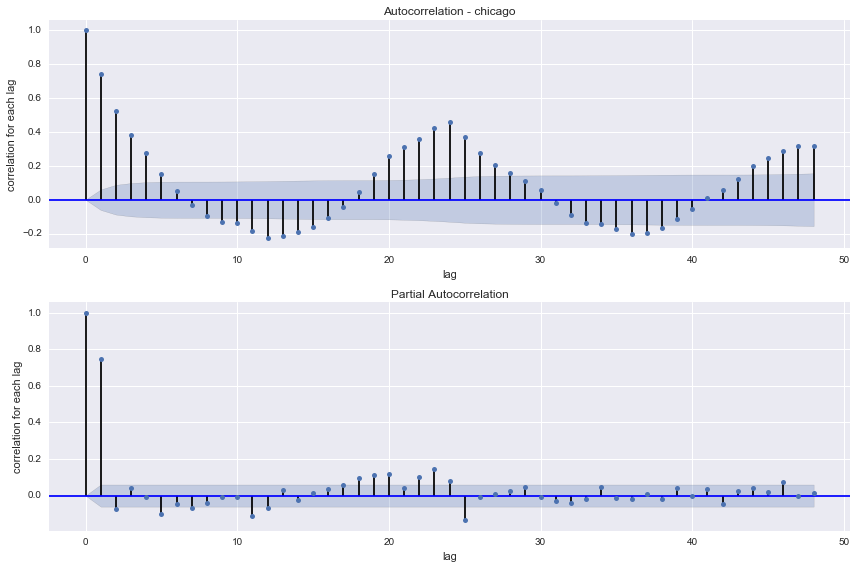

In [96]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
def plot_acf_pacf(data, lags, label):
    """
    Input: Amount of lag
    Output: Plot of ACF/PACF
    """
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = plot_acf(data, lags=lags, ax=ax1)
    ax1.set_ylabel('correlation for each lag')
    ax1.set_xlabel('lag')
    ax1.set_title('Autocorrelation - {}'.format(label))
    ax2 = fig.add_subplot(212)
    fig = plot_pacf(data, lags=lags, ax=ax2)
    ax2.set_xlabel('lag')
    ax2.set_ylabel('correlation for each lag')
    plt.tight_layout()
for city in cities:
    hourly = df.query("display_name == 'uberX' and city == @city")['avg_price_est'].resample('H')
    plot_acf_pacf(hourly, lags=48, label=city)

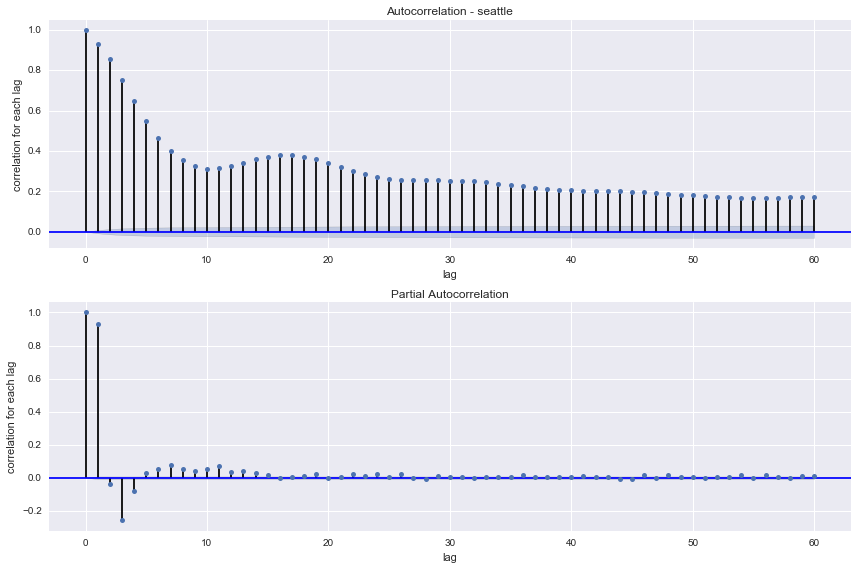

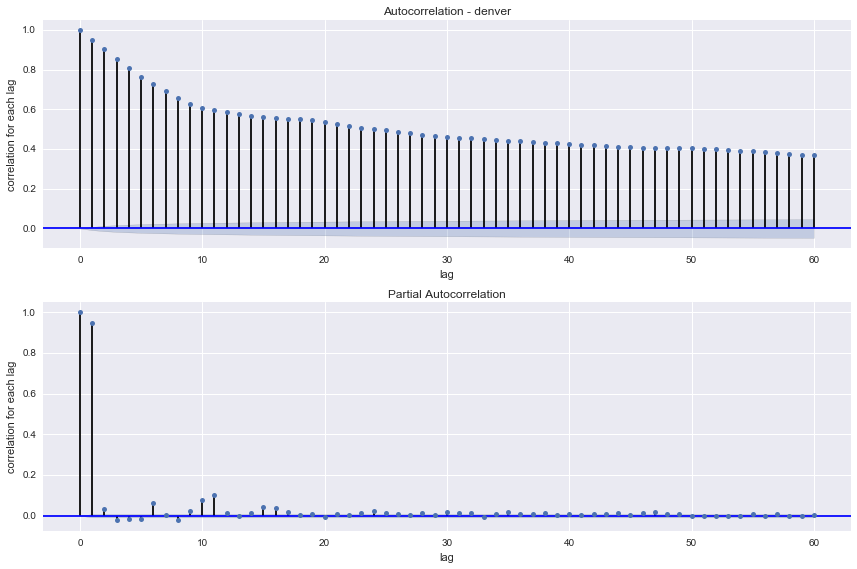

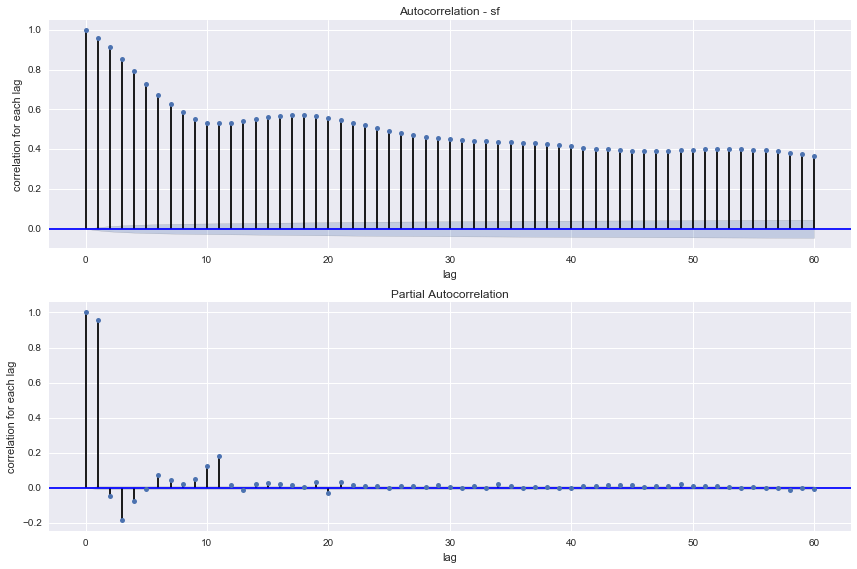

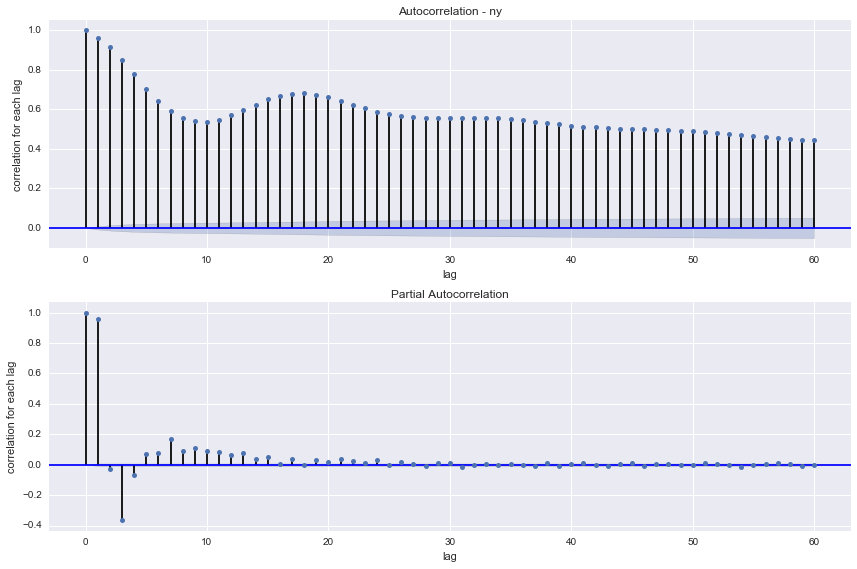

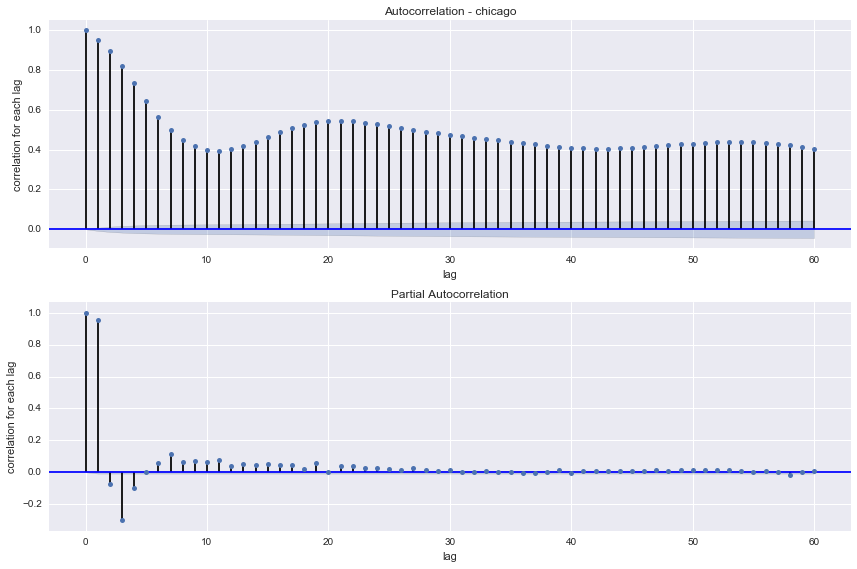

In [4]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
def plot_acf_pacf(data, lags, label):
    """
    Input: Amount of lag
    Output: Plot of ACF/PACF
    """
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = plot_acf(data, lags=lags, ax=ax1)
    ax1.set_ylabel('correlation for each lag')
    ax1.set_xlabel('lag')
    ax1.set_title('Autocorrelation - {}'.format(label))
    ax2 = fig.add_subplot(212)
    fig = plot_pacf(data, lags=lags, ax=ax2)
    ax2.set_xlabel('lag')
    ax2.set_ylabel('correlation for each lag')
    plt.tight_layout()
cities = df['city'].unique().tolist()
for city in cities:
    minutely = df.query("display_name == 'uberX' and city == @city")['avg_price_est']
    plot_acf_pacf(minutely, lags=60, label=city)

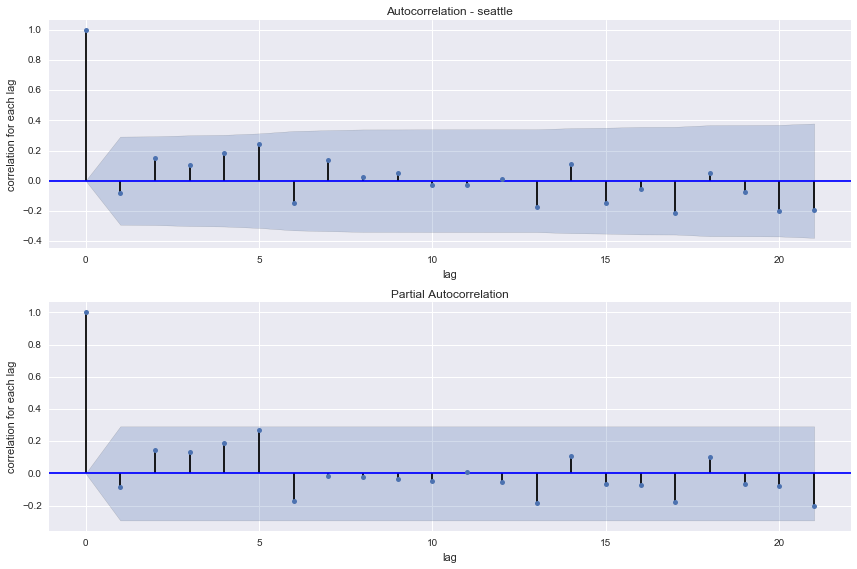

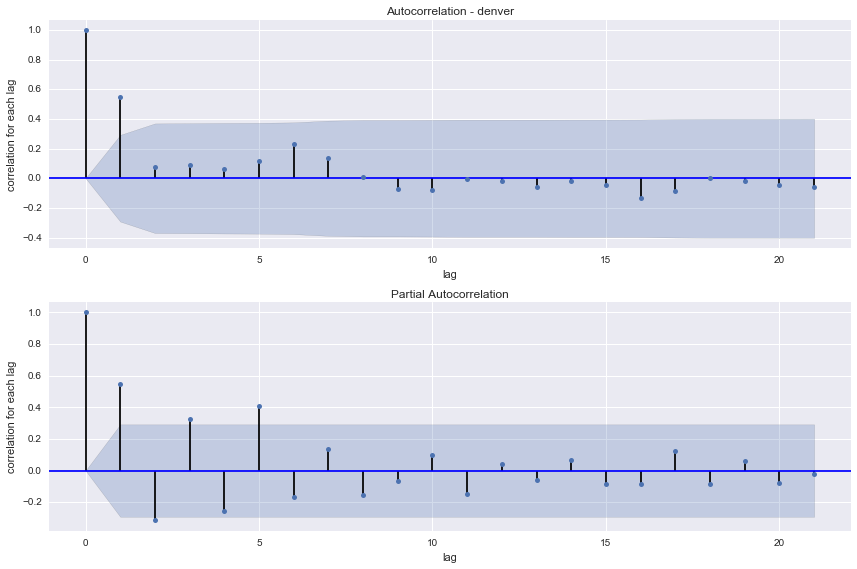

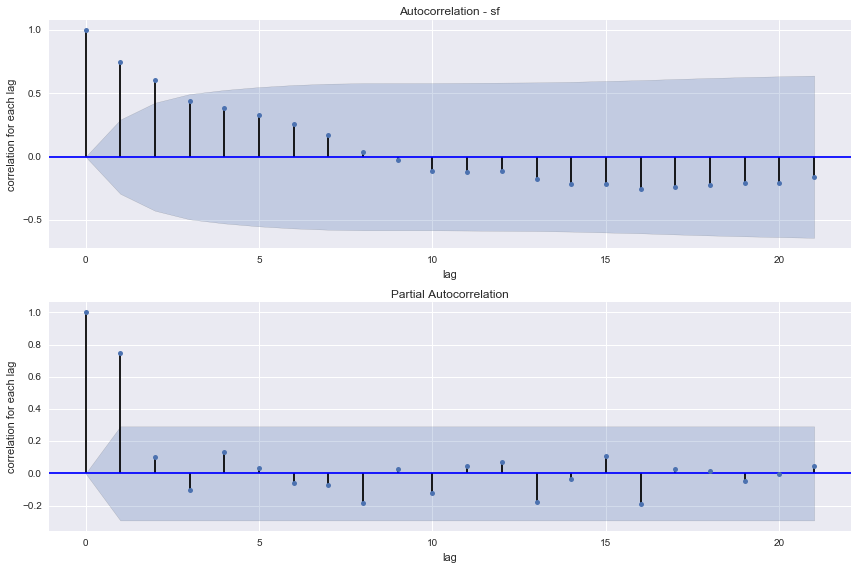

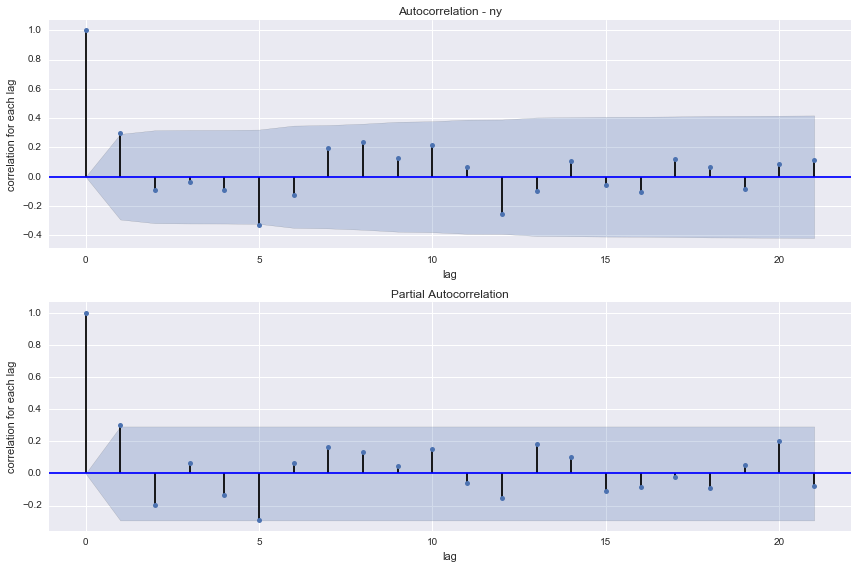

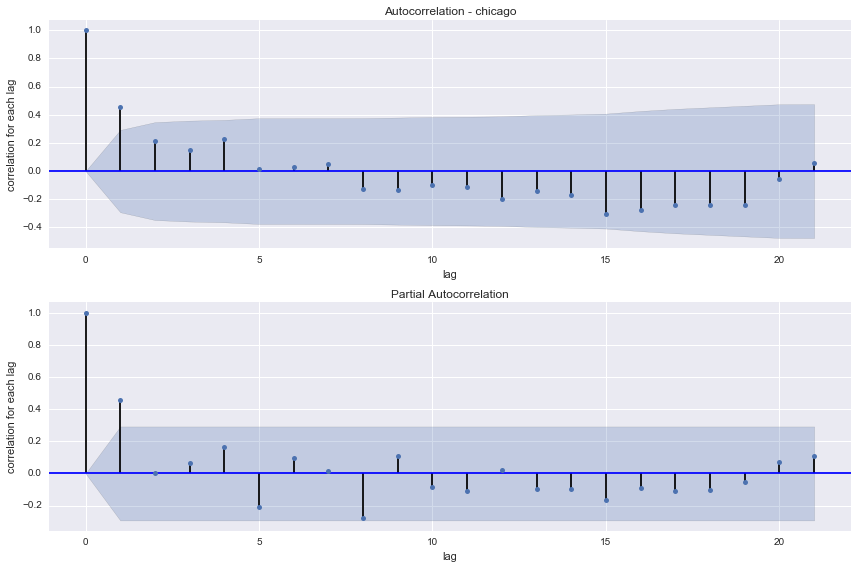

In [782]:
for city in cities:
    daily = df.query("display_name == 'uberX' and city == @city")['avg_price_est'].resample('D')
    plot_acf_pacf(daily, lags=21, label=city)

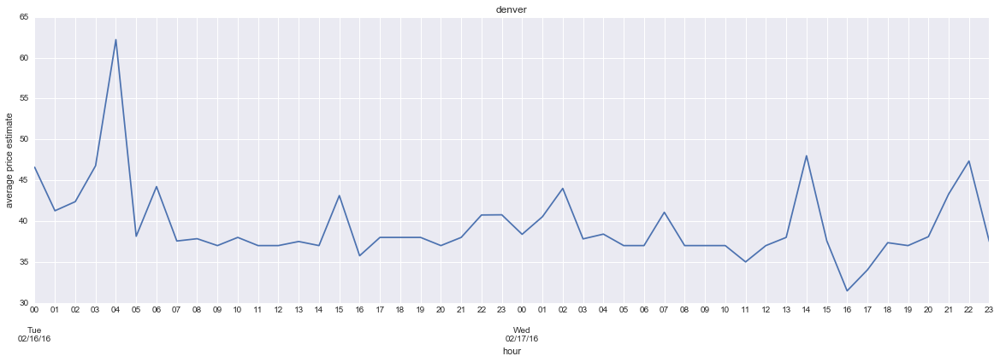

In [29]:
from matplotlib.dates import MonthLocator, WeekdayLocator, DateFormatter, HourLocator

s = df.query("display_name == 'uberX' and city == 'denver'").resample('H').ix['2016-02-16':'2016-02-17']
fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(s.index.to_pydatetime(), s['avg_price_est'].values, '-');

ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('hour')
ax.set_ylabel('average price estimate');
ax.set_title('denver');

### How well does one day predict the next day?

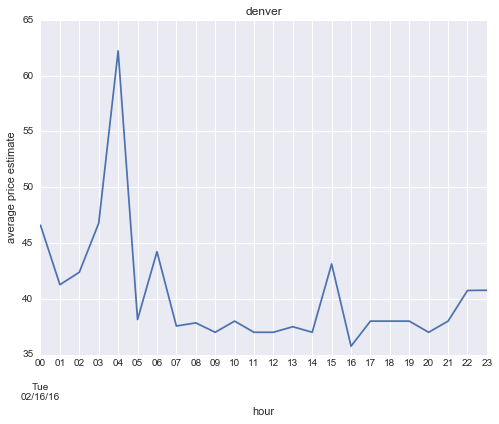

In [784]:
sub_s = df.query("display_name == 'uberX' and city == 'denver'").resample('H').ix['2016-02-16']
fig, ax = plt.subplots(figsize=(8,6))
ax.plot_date(sub_s.index.to_pydatetime(), sub_s['avg_price_est'].values, '-');

ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('hour')
ax.set_ylabel('average price estimate');
ax.set_title('denver');

In [785]:
sub_s['time'] = np.arange(1, sub_s.shape[0]+1)

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.198
Model:                            OLS   Adj. R-squared:                  0.161
Method:                 Least Squares   F-statistic:                     5.426
Date:                Tue, 05 Apr 2016   Prob (F-statistic):             0.0294
Time:                        17:38:54   Log-Likelihood:                -72.192
No. Observations:                  24   AIC:                             148.4
Df Residuals:                      22   BIC:                             150.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [95.0% Conf. Int.]
------------------------------------------------------------------------------
const         44.8051      2.156     20.781      0.000        40.334    49.276
time          -0.3515      0.151     -2.329      0.029        -0.664    -0.039
==============================================================================
Omnibus:                       31.372   Durbin-Watson:                   1.835
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               71.972
Skew:                           2.411   Prob(JB):                     2.35e-16
Kurtosis:                       9.980   Cond. No.                         29.6
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

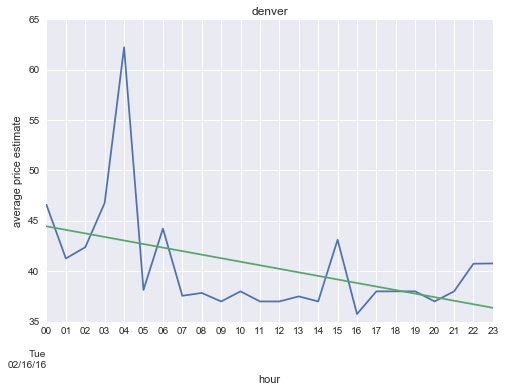

In [786]:
y = sub_s['avg_price_est'].values
X = sub_s['time']
model = sm.OLS(y, sm.add_constant(X)).fit()
fig, ax = plt.subplots(figsize=(8,6))
ax.plot_date(sub_s.index.to_pydatetime(), sub_s['avg_price_est'].values, '-');

ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
pd.Series(model.fittedvalues, index=sub_s.index).plot();
plt.setp(ax.get_xticklabels(), rotation=0);
ax.set_xlabel('hour')
ax.set_ylabel('average price estimate');
ax.set_title('denver');
model.summary()

In [787]:
s['time'] = np.arange(1, s.shape[0]+1)

In [788]:
new_s = s[['avg_price_est','time']].ix['2016-02-17']
new_X = new_s['time']
res = model.predict(sm.add_constant(new_X))

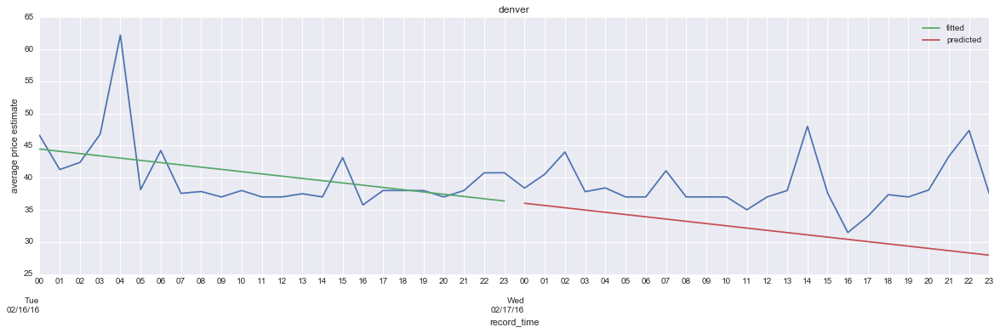

In [789]:
fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(s.index.to_pydatetime(), s['avg_price_est'].values, '-');

ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('hour')
ax.set_ylabel('average price estimate');
ax.set_title('denver');
pd.Series(model.fittedvalues, index=sub_s.index).plot(label='fitted');
plt.plot(new_s.index,res, label='predicted')
plt.setp(ax.get_xticklabels(), rotation=0);
ax.legend(loc='best');

In [790]:
sub_s.columns

Index([u'low_estimate', u'avg_price_est', u'high_estimate', u'trip_duration',
       u'trip_distance', u'surge_multiplier', u'surge_minimum_price',
       u'pickup_estimate', u'capacity', u'base_price', u'base_minimum_price',
       u'cost_per_minute', u'cost_per_distance', u'cancellation_fee',
       u'service_fees', u'start_latitude', u'start_longitude',
       u'stop_latitude', u'stop_longitude', u'hour', u'day', u'dayofweek',
       u'weekofyear', u'time'],
      dtype='object')

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.458
Model:                            OLS   Adj. R-squared:                  0.344
Method:                 Least Squares   F-statistic:                     4.011
Date:                Tue, 05 Apr 2016   Prob (F-statistic):             0.0159
Time:                        17:39:25   Log-Likelihood:                -67.491
No. Observations:                  24   AIC:                             145.0
Df Residuals:                      19   BIC:                             150.9
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [95.0% Conf. Int.]
--------------------------------------------------------------------------------------
trip_duration         -0.0080      0.005     -1.519      0.145        -0.019     0.003
trip_distance          1.2668      0.934      1.356      0.191        -0.688     3.222
pickup_estimate        0.0395      0.015      2.630      0.017         0.008     0.071
capacity               0.2084      0.309      0.675      0.508        -0.437     0.854
base_price             0.0391      0.058      0.675      0.508        -0.082     0.160
base_minimum_price     0.2579      0.382      0.675      0.508        -0.541     1.057
cost_per_minute        0.0068      0.010      0.675      0.508        -0.014     0.028
cost_per_distance      0.0521      0.077      0.675      0.508        -0.109     0.214
cancellation_fee       0.2605      0.386      0.675      0.508        -0.547     1.068
service_fees           0.1016      0.150      0.675      0.508        -0.213     0.416
hour                  -0.3024      0.145     -2.082      0.051        -0.606     0.002
day                    0.8337      1.234      0.675      0.508        -1.750     3.417
dayofweek              0.0521      0.077      0.675      0.508        -0.109     0.214
weekofyear             0.3648      0.540      0.675      0.508        -0.766     1.495
==============================================================================
Omnibus:                       43.844   Durbin-Watson:                   2.459
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              185.127
Skew:                           3.186   Prob(JB):                     6.31e-41
Kurtosis:                      15.022   Cond. No.                     1.17e+40
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 8.42e-73. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

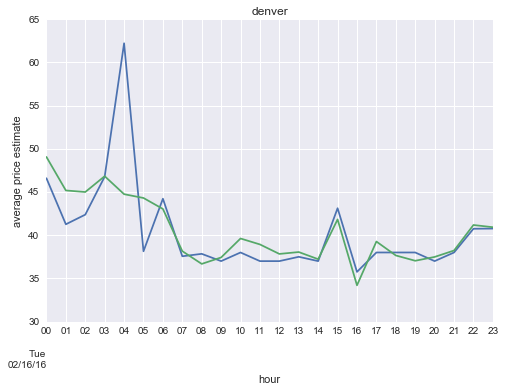

In [792]:
features = ['trip_duration','trip_distance','pickup_estimate',
            'capacity','base_price','base_minimum_price','cost_per_minute',
            'cost_per_distance','cancellation_fee','service_fees','hour','day',
           'dayofweek','weekofyear']
y = sub_s['avg_price_est'].values
X = sub_s[features]
model = sm.OLS(y, sm.add_constant(X)).fit()
fig, ax = plt.subplots(figsize=(8,6))
ax.plot_date(sub_s.index.to_pydatetime(), sub_s['avg_price_est'].values, '-');

ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
pd.Series(model.fittedvalues, index=sub_s.index).plot();
plt.setp(ax.get_xticklabels(), rotation=0);
ax.set_xlabel('hour')
ax.set_ylabel('average price estimate');
ax.set_title('denver');
model.summary()

### How well will the model forecast prices for a week?

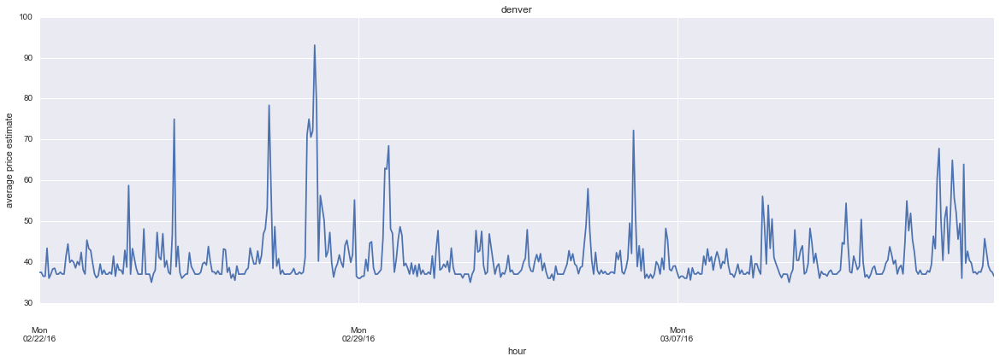

In [5]:
from matplotlib.dates import MonthLocator, WeekdayLocator, DateFormatter, HourLocator

s = df.query("display_name == 'uberX' and city == 'denver' and weekofyear >= 8 and weekofyear <= 10").resample('H')
fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(s.index.to_pydatetime(), s['avg_price_est'].values, '-');

# ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
# ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=7))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('hour')
ax.set_ylabel('average price estimate');
ax.set_title('denver');

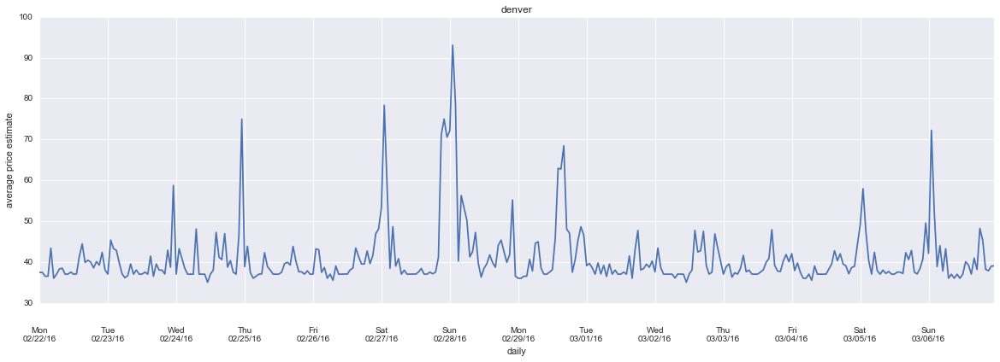

In [6]:
from matplotlib.dates import MonthLocator, WeekdayLocator, DateFormatter, HourLocator

s = df.query("display_name == 'uberX' and city == 'denver' and weekofyear >= 8 and weekofyear <= 9").resample('H')
fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(s.index.to_pydatetime(), s['avg_price_est'].values, '-');

# ax.xaxis.set_minor_locator(HourLocator(byhour=range(24), interval=1))
# ax.xaxis.set_minor_formatter(DateFormatter('%H'))
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('daily')
ax.set_ylabel('average price estimate');
ax.set_title('denver');

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.867
Model:                            OLS   Adj. R-squared:                  0.867
Method:                 Least Squares   F-statistic:                 7.546e+04
Date:                Sat, 09 Apr 2016   Prob (F-statistic):               0.00
Time:                        20:53:37   Log-Likelihood:            -2.1957e+06
No. Observations:              553407   AIC:                         4.392e+06
Df Residuals:                  553358   BIC:                         4.392e+06
Df Model:                          48                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [95.0% Conf. Int.]
--------------------------------------------------------------------------------------------
trip_duration           

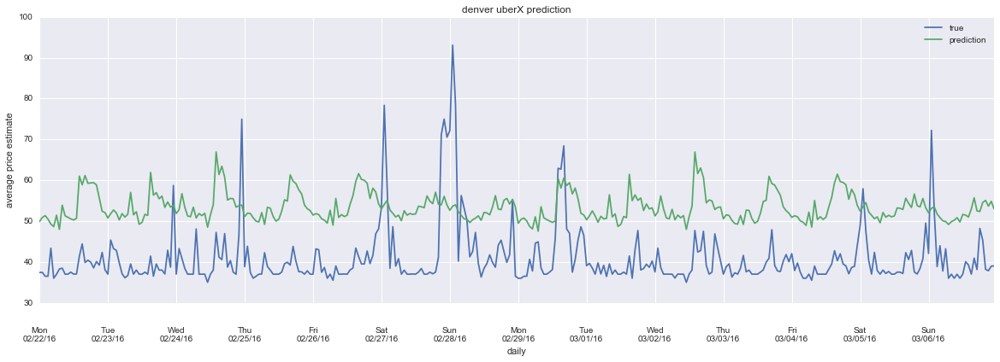

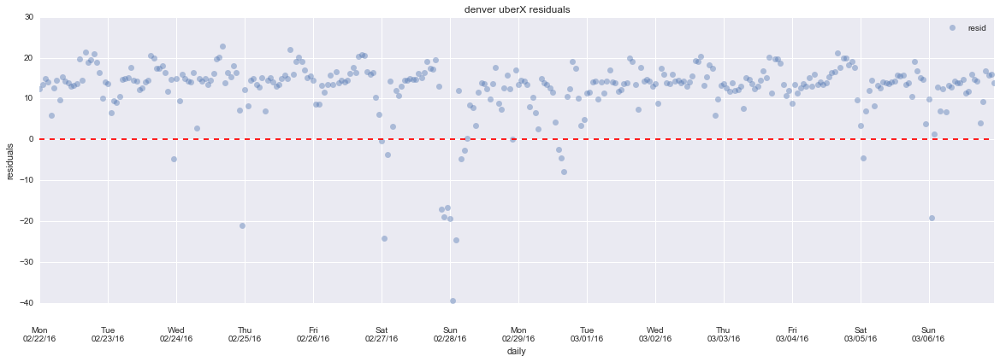

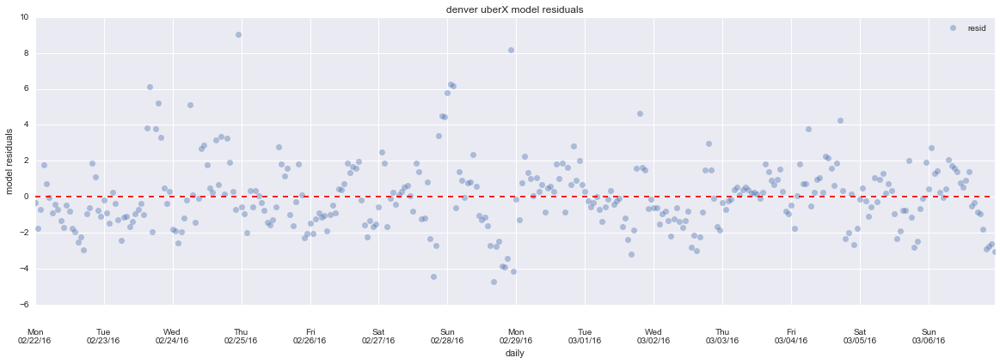

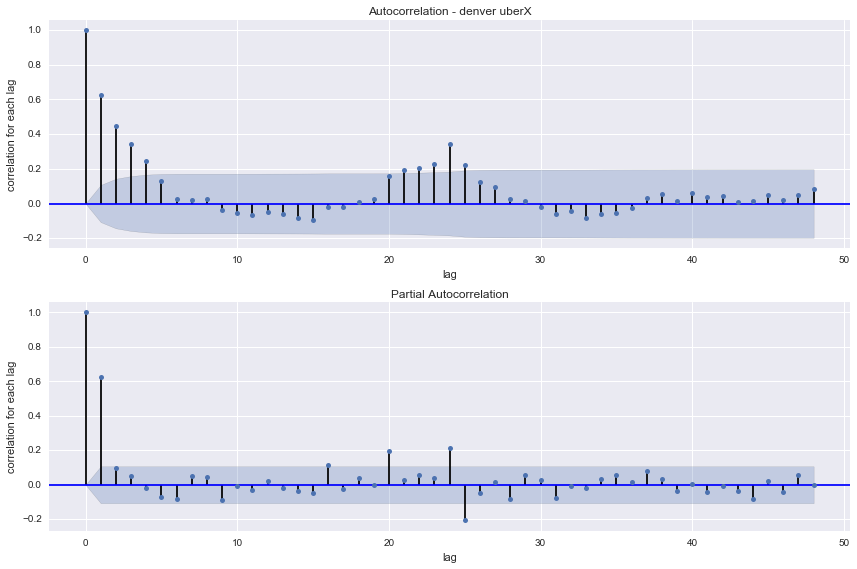

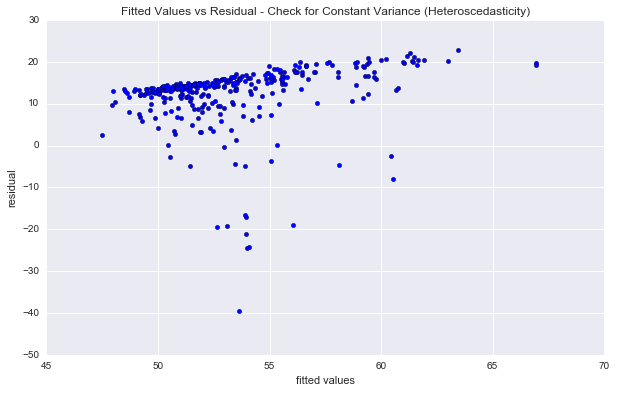

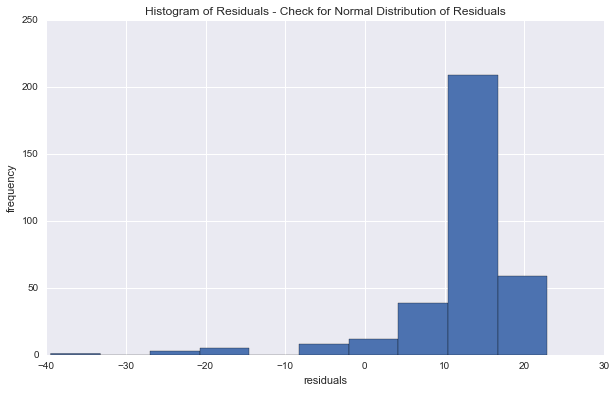

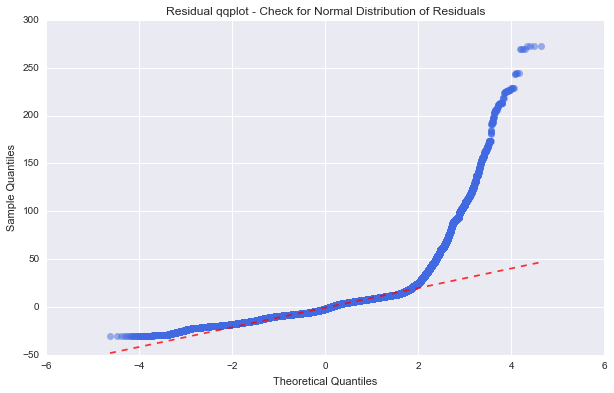

In [7]:
import statsmodels.api as sm
import scipy.stats as scs

# df['lag_1'] = df['avg_price_est'].diff(periods=1)
features = ['avg_price_est','city','display_name','trip_duration','trip_distance','hour','dayofweek','weekofyear','pickup_estimate','surge_multiplier']
sample = pd.get_dummies(df[features], columns=['city','display_name','hour','dayofweek','weekofyear']).drop(['city_chicago','display_name_uberASSIST','hour_0','dayofweek_0','weekofyear_7'], axis=1).dropna()

train_set = sample.query("weekofyear_8 == 1 or weekofyear_9 == 1")
test_set = sample.query("weekofyear_10 == 1")

y = train_set['avg_price_est'].values
X = train_set[train_set.columns[1:]]
model = sm.OLS(y, sm.add_constant(X)).fit()
y_pred = model.fittedvalues
trainplot = pd.concat([train_set, pd.DataFrame(y_pred, columns=['y_pred'])], axis=1)
trainplot['resid'] = trainplot['y_pred'] - trainplot['avg_price_est']
trainplot = trainplot.query("display_name_uberX == 1 and city_denver == 1").resample('H')

print model.summary()

fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(trainplot.index.to_pydatetime(), trainplot['avg_price_est'].values, '-', label='true');
ax.plot_date(trainplot.index.to_pydatetime(), trainplot['y_pred'].values, '-', label='prediction');
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('daily')
ax.set_ylabel('average price estimate');
ax.set_title('denver uberX prediction');
ax.legend(loc='upper right')

fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(trainplot.index.to_pydatetime(), trainplot['resid'].values, 'o', label='resid', alpha=0.4);
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.axhline(0, color='r', ls='--')
ax.set_xlabel('daily')
ax.set_ylabel('residuals');
ax.set_title('denver uberX residuals');
ax.legend(loc='upper right')

fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(model.resid.resample('H').index.to_pydatetime(), model.resid.resample('H').values, 'o', label='resid', alpha=0.4);
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.axhline(0, color='r', ls='--')
ax.set_xlabel('daily')
ax.set_ylabel('model residuals');
ax.set_title('denver uberX model residuals');
ax.legend(loc='upper right')

plot_acf_pacf(trainplot['resid'], lags=48, label='denver uberX')

fig, ax = plt.subplots(figsize=(10,6))
ax.scatter(trainplot['y_pred'], trainplot['resid'])
ax.set_title("Fitted Values vs Residual - Check for Constant Variance (Heteroscedasticity)")
ax.set_xlabel("fitted values")
ax.set_ylabel("residual")

fig, ax = plt.subplots(figsize=(10,6))
ax.hist(trainplot['resid'])
ax.set_title("Histogram of Residuals - Check for Normal Distribution of Residuals")
ax.set_xlabel("residuals")
ax.set_ylabel("frequency")

fig, ax = plt.subplots(figsize=(10,6))
sm.graphics.qqplot(model.resid, scs.norm, line='q', ax=ax)
ax.set_title('Residual qqplot - Check for Normal Distribution of Residuals');
line1 = ax.get_lines()[1]
line1.set_linestyle('--')
line1.set_alpha(0.8)
line2 = ax.get_lines()[0]
line2.set_color('royalblue')
line2.set_alpha(0.5)

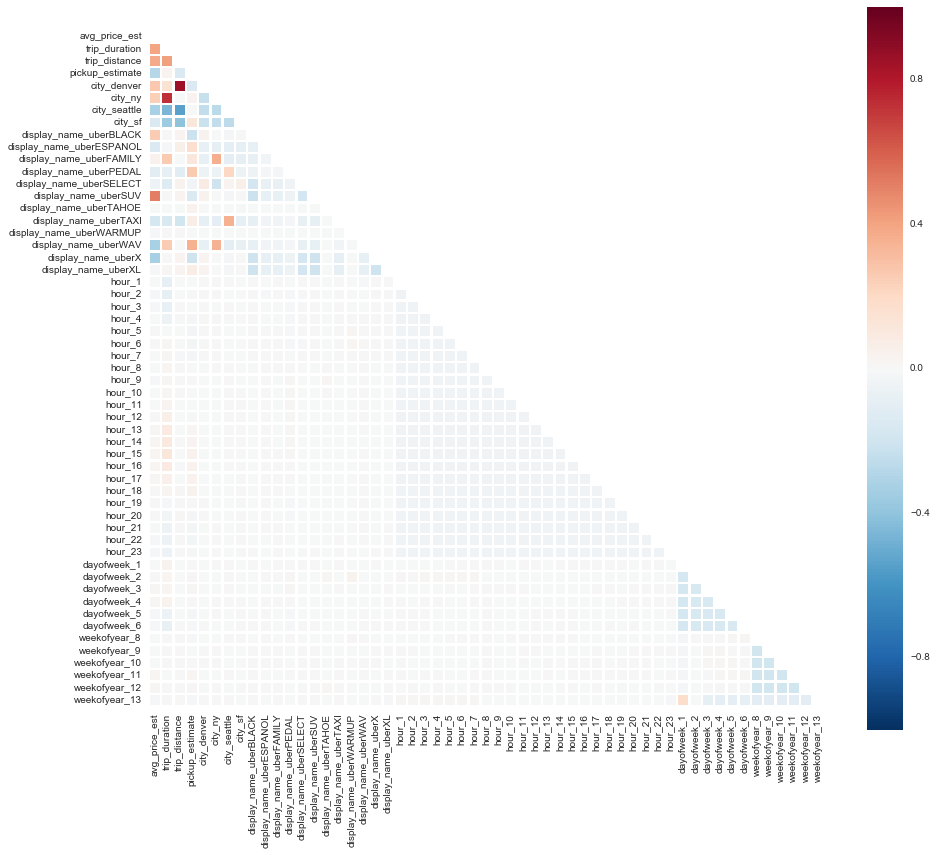

In [9]:
# df['lag_1'] = df['avg_price_est'].diff(periods=1)
features = ['avg_price_est','city','display_name','trip_duration', 'trip_distance','hour','dayofweek','weekofyear','pickup_estimate']
sample = pd.get_dummies(df[features], columns=['city','display_name','hour','dayofweek','weekofyear']).drop(['city_chicago','display_name_uberASSIST','hour_0','dayofweek_0','weekofyear_7'], axis=1).dropna()

fs = sample.corr()
mask = np.zeros_like(fs)
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(14,12))
with sns.axes_style("white"):
    sns.heatmap(fs, mask=mask, square=True, annot=False, linewidths=1.5)
plt.yticks(rotation=0)
plt.xticks(rotation=90)
plt.tight_layout();

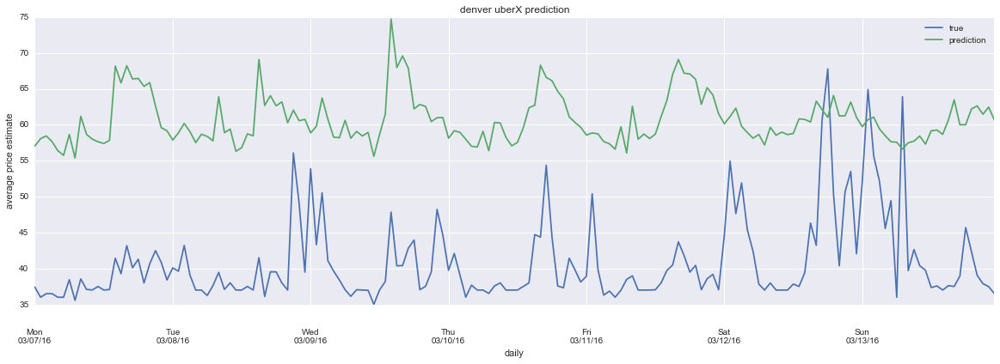

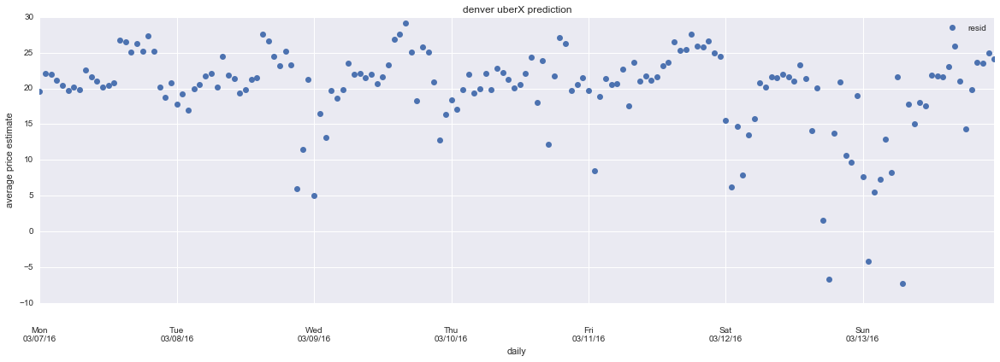

In [10]:
test_pred = model.predict(test_set[test_set.columns[1:]])
testplot = pd.concat([test_set.reset_index(), pd.DataFrame(test_pred, columns=['y_pred'])], axis=1).set_index('record_time')
testplot['resid'] = testplot['y_pred'] - testplot['avg_price_est'] 
testplot = testplot.query("display_name_uberX == 1 and city_denver == 1").resample('H')

fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(testplot.index.to_pydatetime(), testplot['avg_price_est'].values, '-', label='true');
ax.plot_date(testplot.index.to_pydatetime(), testplot['y_pred'].values, '-', label='prediction');
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('daily')
ax.set_ylabel('average price estimate');
ax.set_title('denver uberX prediction');
ax.legend(loc='upper right')

fig, ax = plt.subplots(figsize=(20,6))
ax.plot_date(testplot.index.to_pydatetime(), testplot['resid'].values, 'o', label='resid');
ax.xaxis.set_major_locator(WeekdayLocator(byweekday=range(7), interval=1))
ax.xaxis.set_major_formatter(DateFormatter('\n\n%a\n%D'))
ax.xaxis.grid(True, which="minor")
ax.set_xlabel('daily')
ax.set_ylabel('average price estimate');
ax.set_title('denver uberX prediction');
ax.legend(loc='upper right');

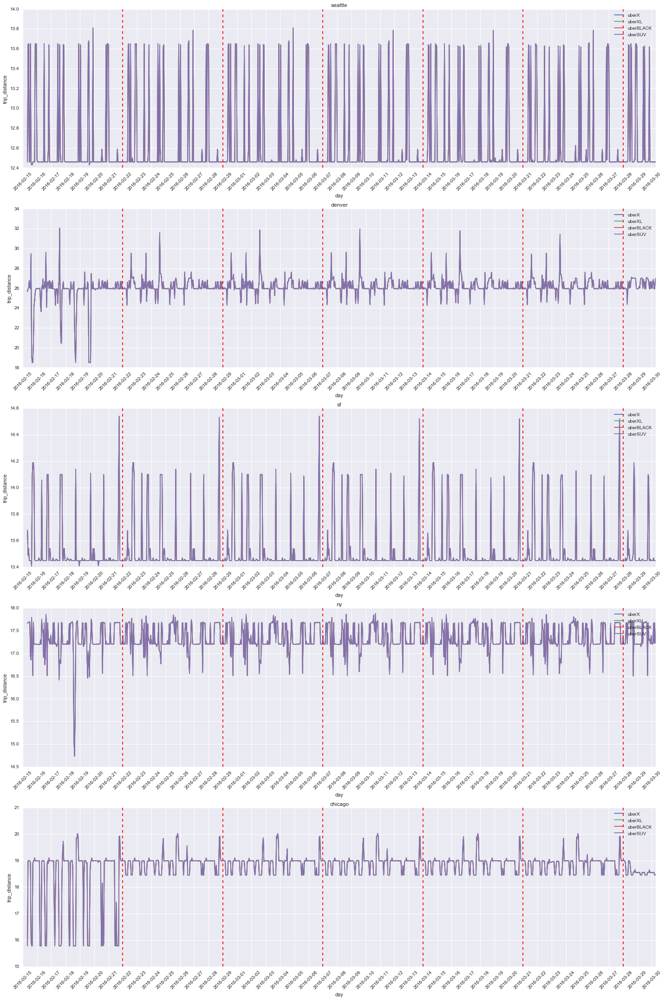

In [6]:
from matplotlib.dates import strpdate2num

cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['trip_distance']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    for cartype in cartypes:
        data = df.query("display_name == @cartype and city == @cities[@i]").resample('H')
        axs.plot(data['trip_distance'], label=cartype)
    axs.set_title(cities[i])
    axs.set_ylabel('trip_distance')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    for date in ['2016-02-22','2016-02-29','2016-03-07','2016-03-14','2016-03-21','2016-03-28']:
        axs.axvline(pd.to_datetime(date), color='r', linestyle='--')
    axs.legend(loc='upper right')
plt.tight_layout()

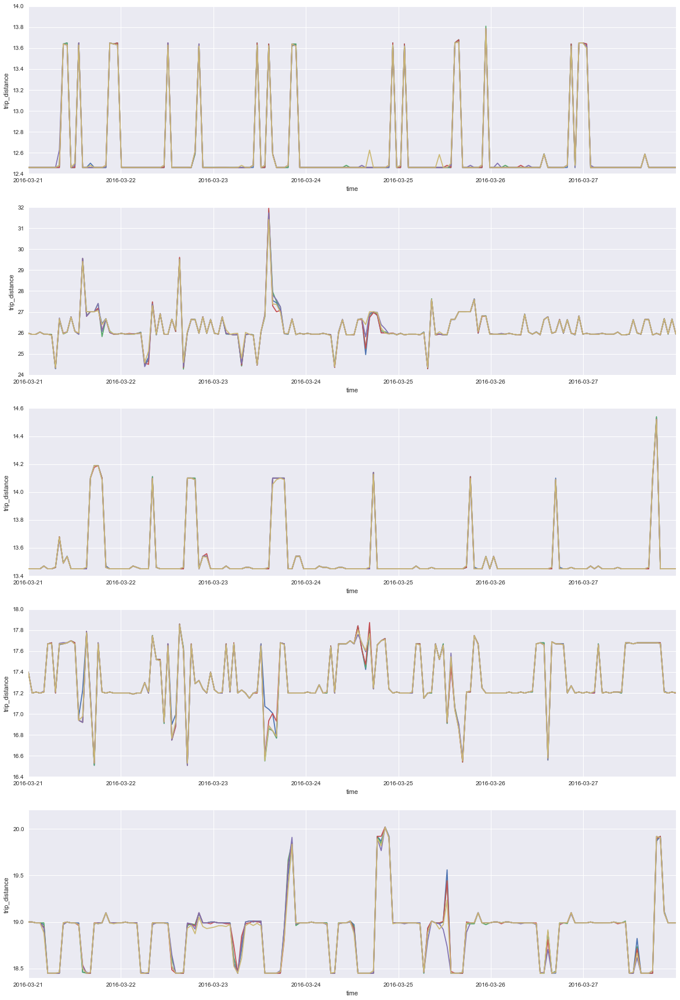

In [794]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['trip_distance'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('trip_distance')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)

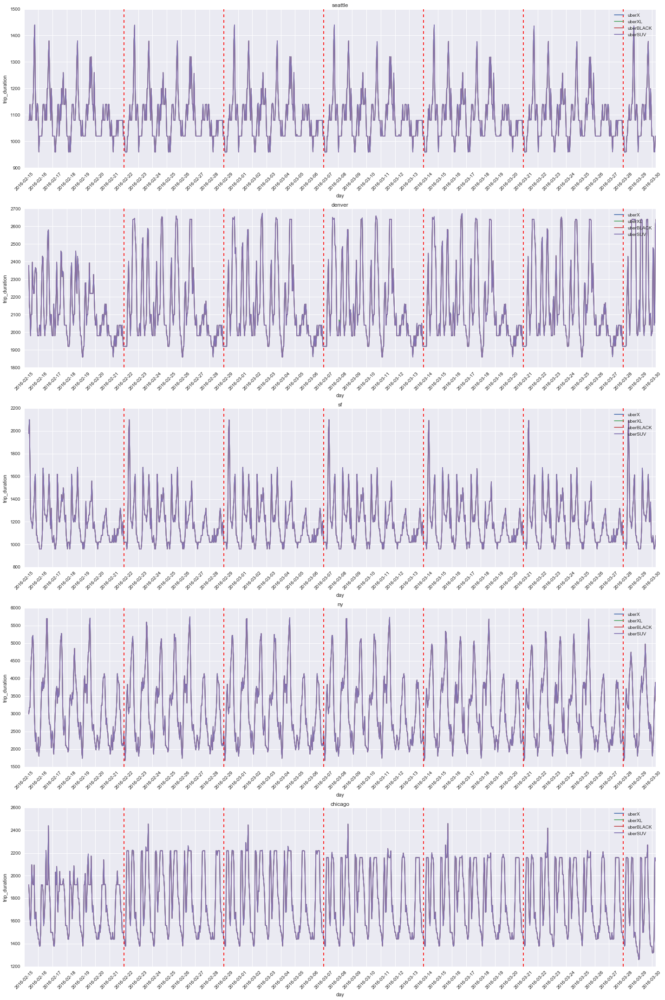

In [795]:
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['trip_duration']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    for cartype in cartypes:
        data = df.query("display_name == @cartype and city == @cities[@i]")['trip_duration'].resample('H')
        axs.plot(data, label=cartype)
    axs.set_title(cities[i])
    axs.set_ylabel('trip_duration')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    for date in ['2016-02-22','2016-02-29','2016-03-07','2016-03-14','2016-03-21','2016-03-28']:
        axs.axvline(pd.to_datetime(date), color='r', linestyle='--')
    axs.legend(loc='upper right')
plt.tight_layout()

In [14]:
np.unique(df.query("weekofyear == 7").index.date)

array([datetime.date(2016, 2, 15), datetime.date(2016, 2, 16),
       datetime.date(2016, 2, 17), datetime.date(2016, 2, 18),
       datetime.date(2016, 2, 19), datetime.date(2016, 2, 20),
       datetime.date(2016, 2, 21)], dtype=object)

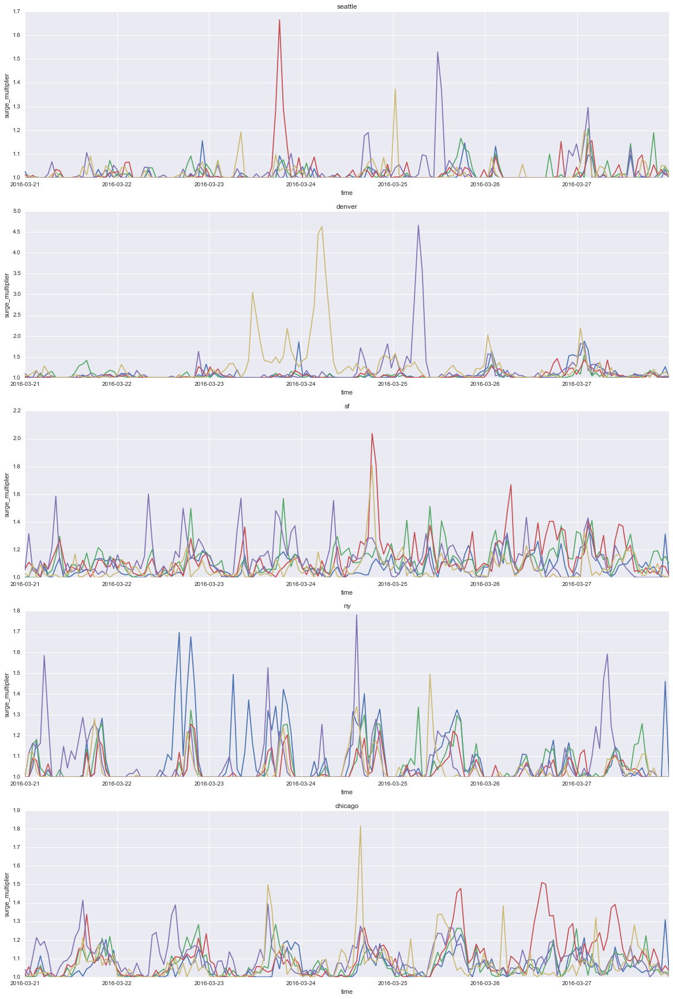

In [15]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['surge_multiplier'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('surge_multiplier')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

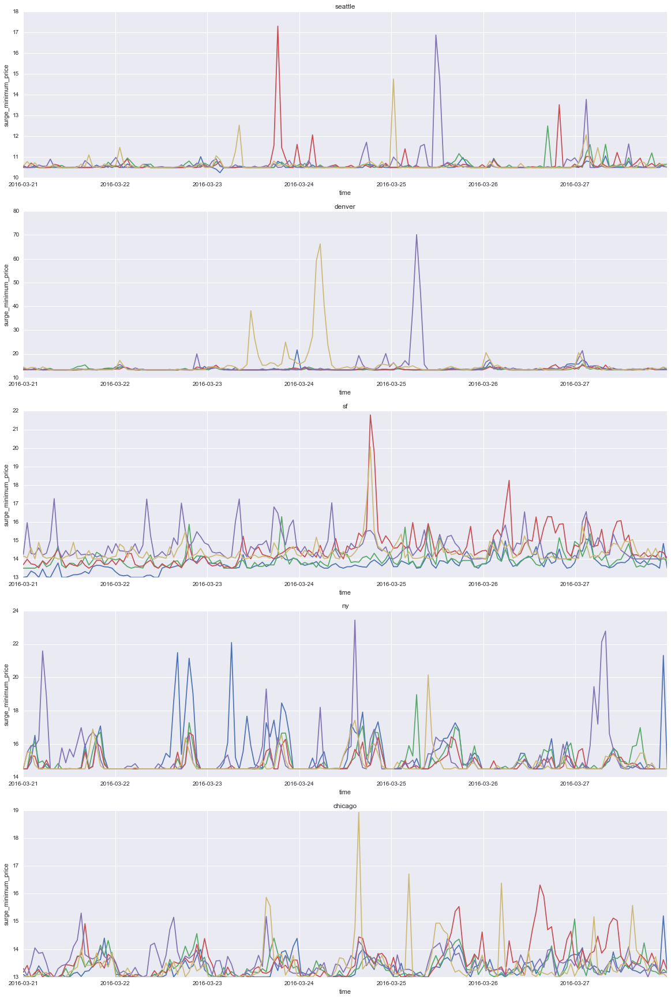

In [16]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['surge_minimum_price'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('surge_minimum_price')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

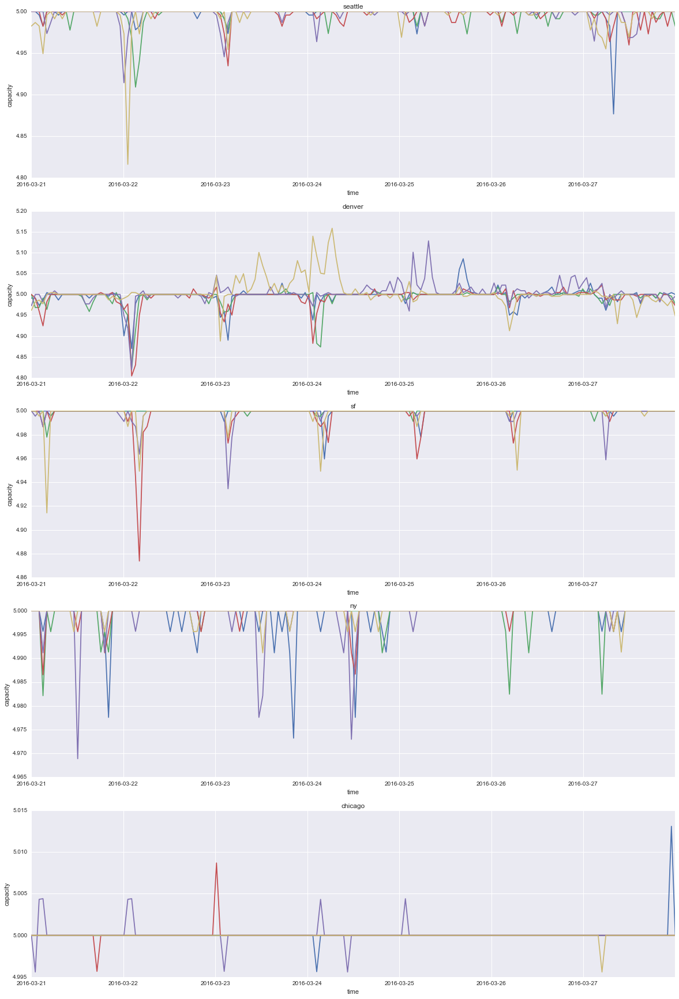

In [17]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['capacity'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('capacity')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

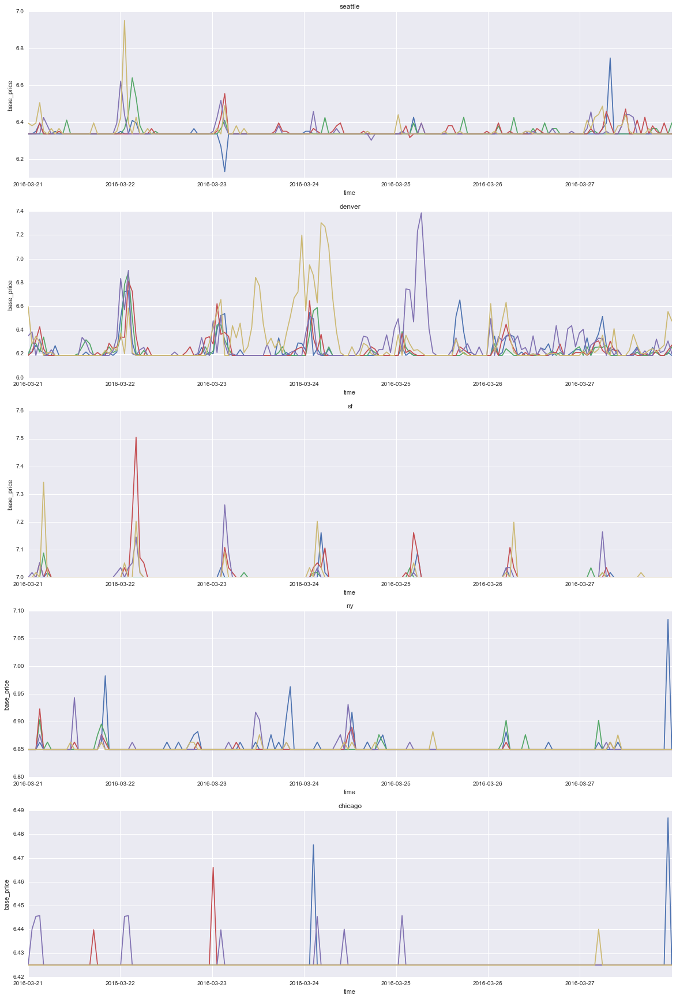

In [18]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['base_price'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('base_price')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

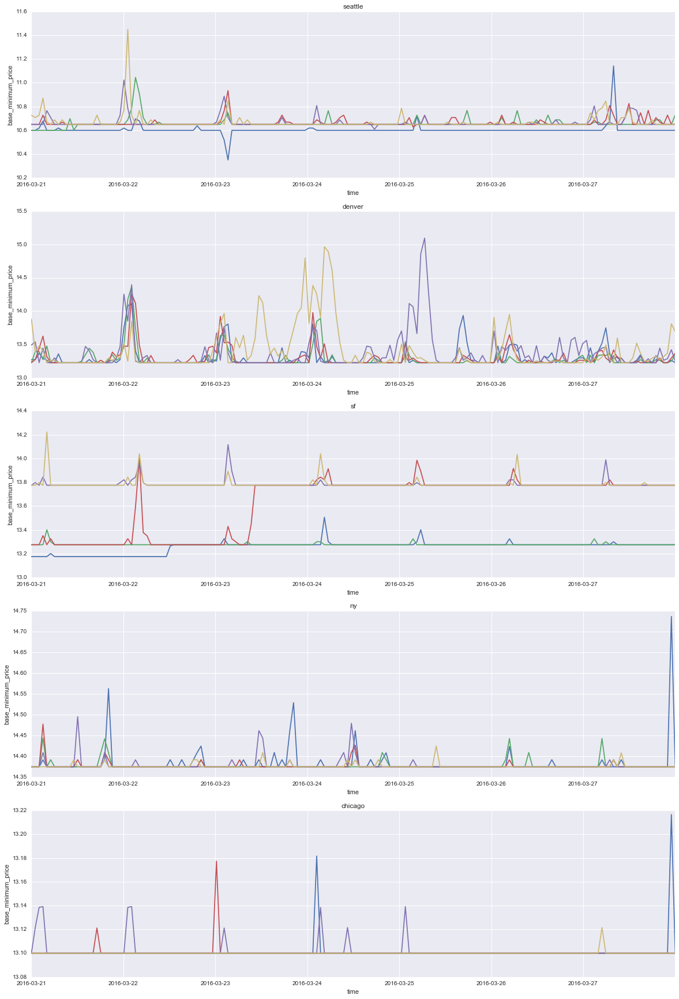

In [19]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['base_minimum_price'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('base_minimum_price')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

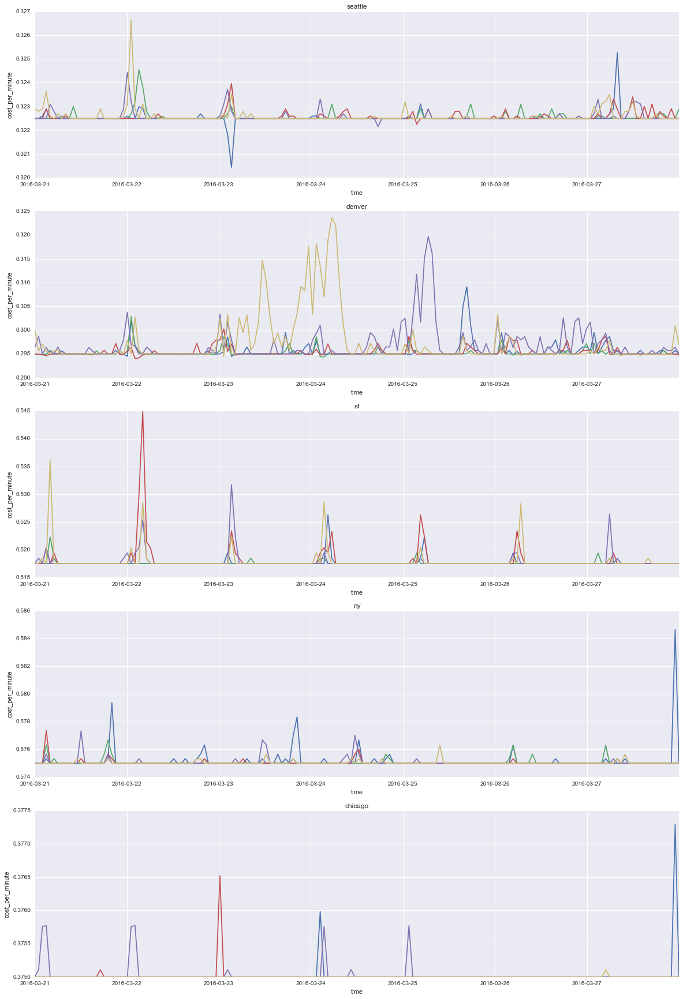

In [20]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['cost_per_minute'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('cost_per_minute')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

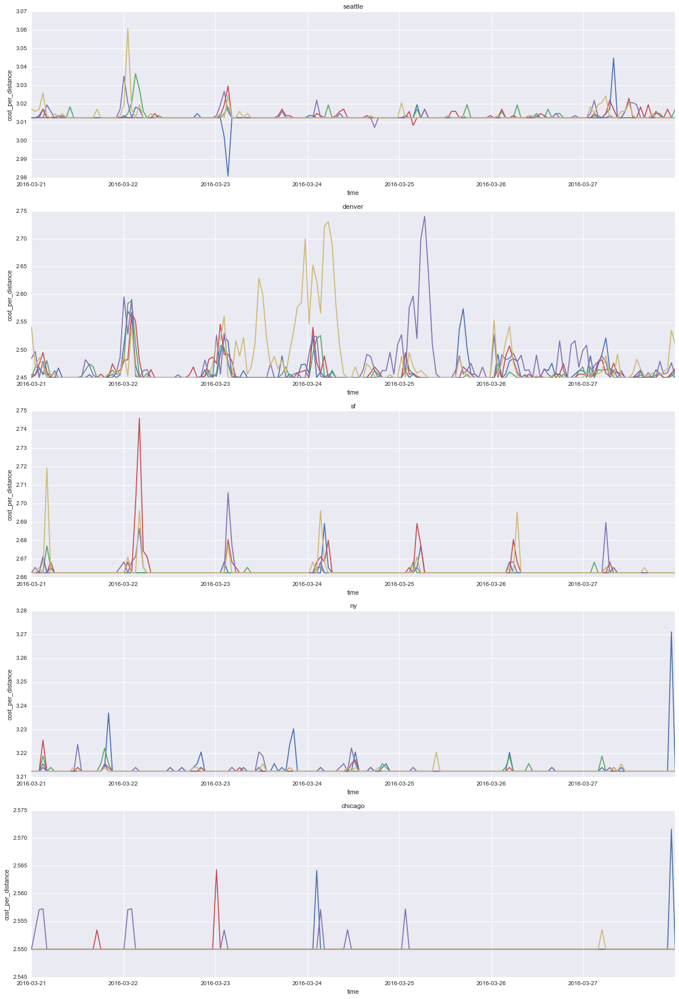

In [21]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['cost_per_distance'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('cost_per_distance')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

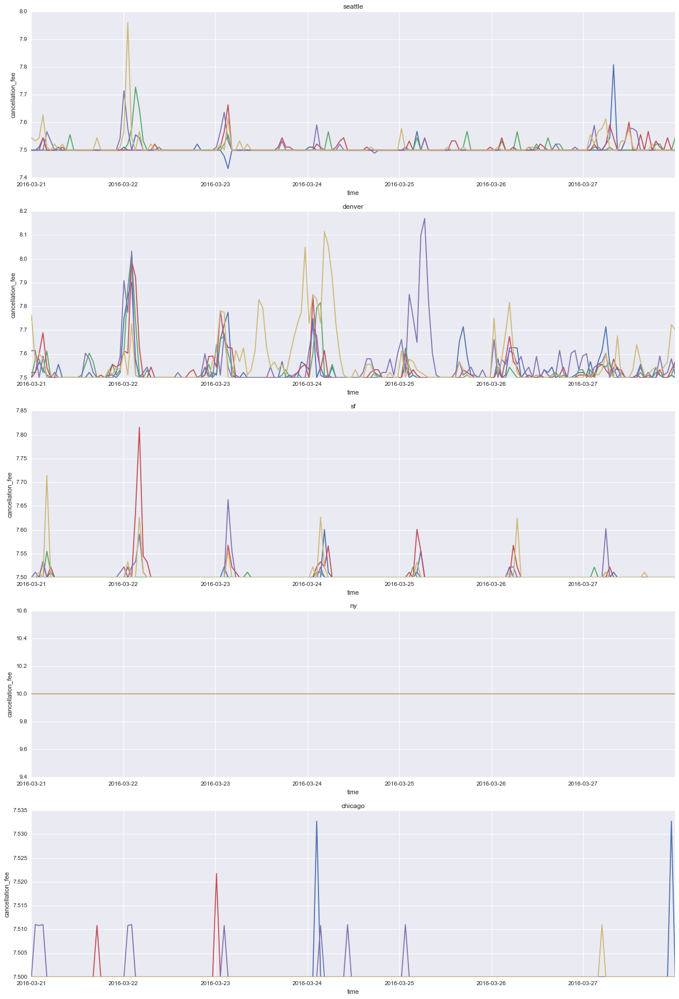

In [23]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['cancellation_fee'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('cancellation_fee')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

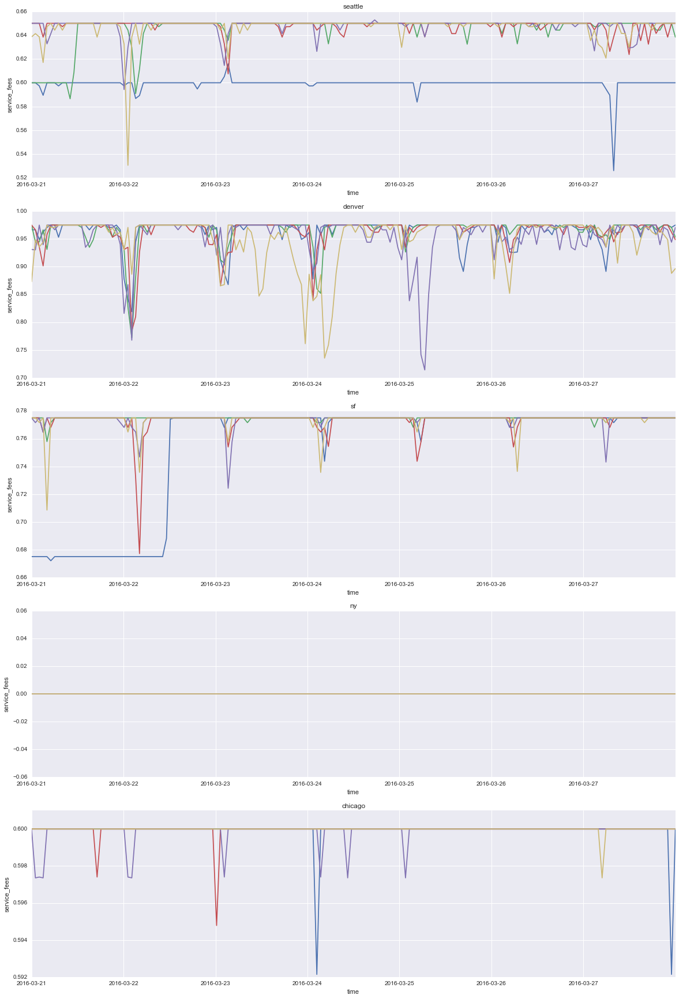

In [24]:
# can't use this
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name in @cartypes").ix[start:end].resample('H')
        axs.plot(data.reset_index()['service_fees'])
        dates = np.unique(data.index.date)
        axs.set_ylabel('service_fees')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.set_title(cities[i])

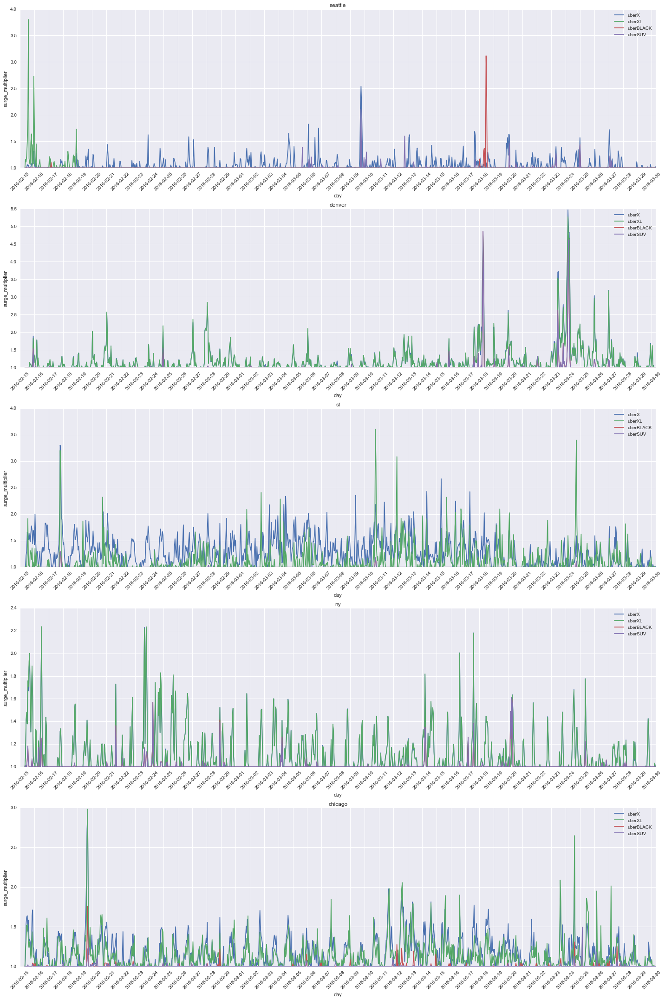

In [798]:
features = ['avg_price_est','trip_duration','trip_distance',
            'surge_multiplier','surge_minimum_price','pickup_estimate',
            'capacity','base_price','base_minimum_price','cost_per_minute',
            'cost_per_distance','cancellation_fee','service_fees','hour','day',
           'date','dayofweek','minute']
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['surge_multiplier']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    for cartype in cartypes:
        data = df.query("display_name == @cartype and city == @cities[@i]")['surge_multiplier'].resample('H')
        axs.plot(data, label=cartype)
    axs.set_title(cities[i])
    axs.set_ylabel('surge_multiplier')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.legend(loc='upper right')
plt.tight_layout()

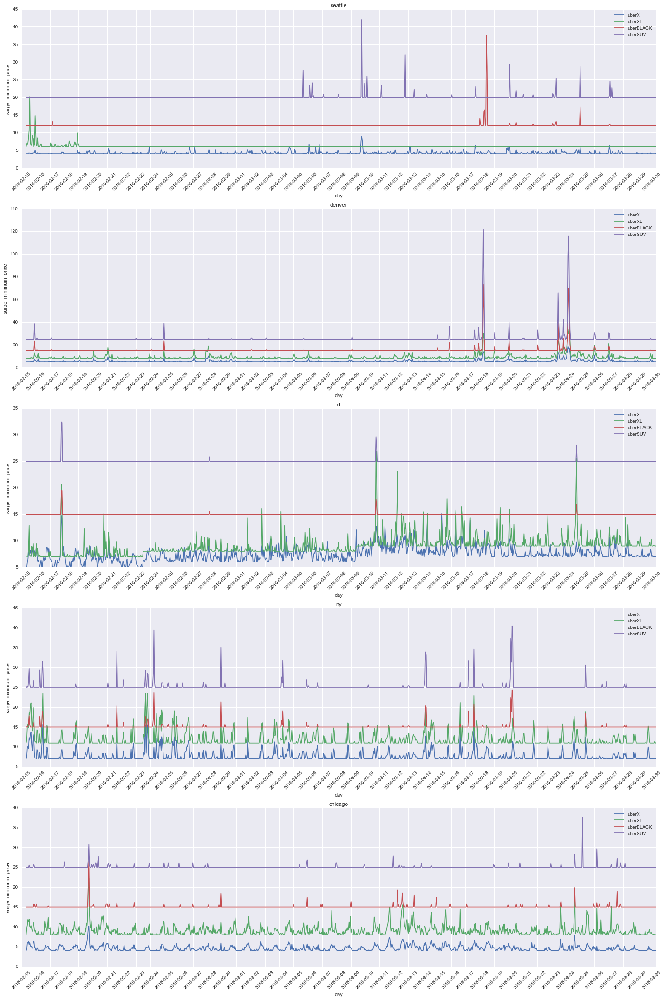

In [799]:
features = ['avg_price_est','trip_duration','trip_distance',
            'surge_multiplier','surge_minimum_price','pickup_estimate',
            'capacity','base_price','base_minimum_price','cost_per_minute',
            'cost_per_distance','cancellation_fee','service_fees','hour','day',
           'date','dayofweek','minute']
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['surge_minimum_price']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    for cartype in cartypes:
        data = df.query("display_name == @cartype and city == @cities[@i]")['surge_minimum_price'].resample('H')
        axs.plot(data, label=cartype)
    axs.set_title(cities[i])
    axs.set_ylabel('surge_minimum_price')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    axs.legend(loc='upper right')
plt.tight_layout()

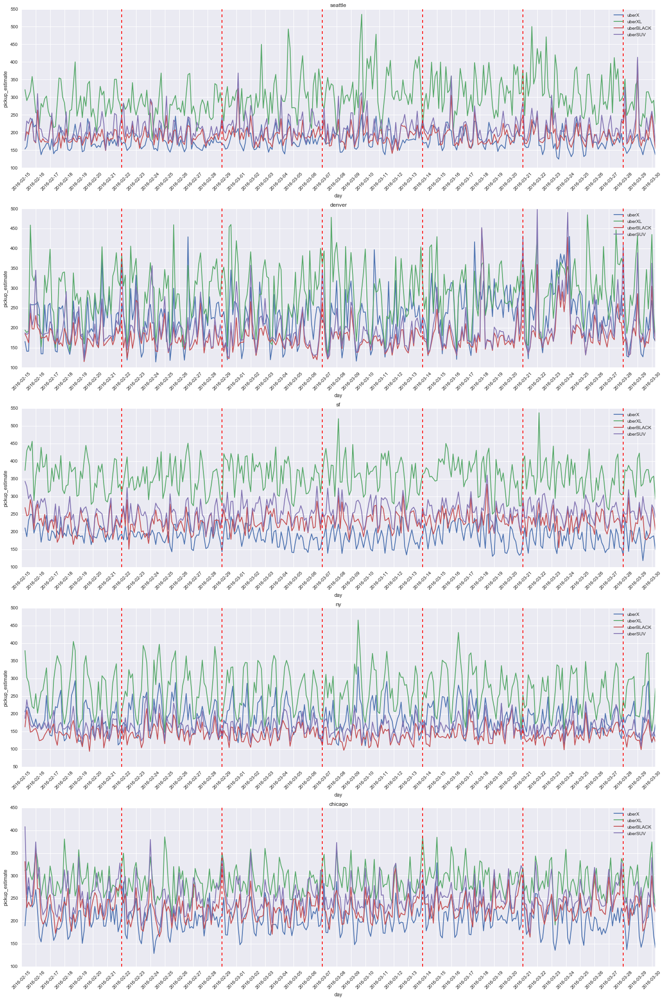

In [800]:
features = ['avg_price_est','trip_duration','trip_distance',
            'surge_multiplier','surge_minimum_price','pickup_estimate',
            'capacity','base_price','base_minimum_price','cost_per_minute',
            'cost_per_distance','cancellation_fee','service_fees','hour','day',
           'date','dayofweek','minute']
cartypes = ['uberX','uberXL','uberBLACK','uberSUV']
fig, ax = plt.subplots(5,1, figsize=(20,30))
d = df.query("display_name == 'uberX' and city == 'denver'")['pickup_estimate']
dates = np.unique(d.index.date)
for i, axs in enumerate(ax.reshape(5,)):
    for cartype in cartypes:
        data = df.query("display_name == @cartype and city == @cities[@i]")['pickup_estimate'].resample('3H')
        axs.plot(data, label=cartype)
    axs.set_title(cities[i])
    axs.set_ylabel('pickup_estimate')
    axs.set_xlabel('day')
    axs.set_xticks(dates)
    axs.set_xticklabels(dates, rotation='45')
    for date in ['2016-02-22','2016-02-29','2016-03-07','2016-03-14','2016-03-21','2016-03-28']:
        axs.axvline(pd.to_datetime(date), color='r', linestyle='--')
    axs.legend(loc='upper right')
plt.tight_layout()

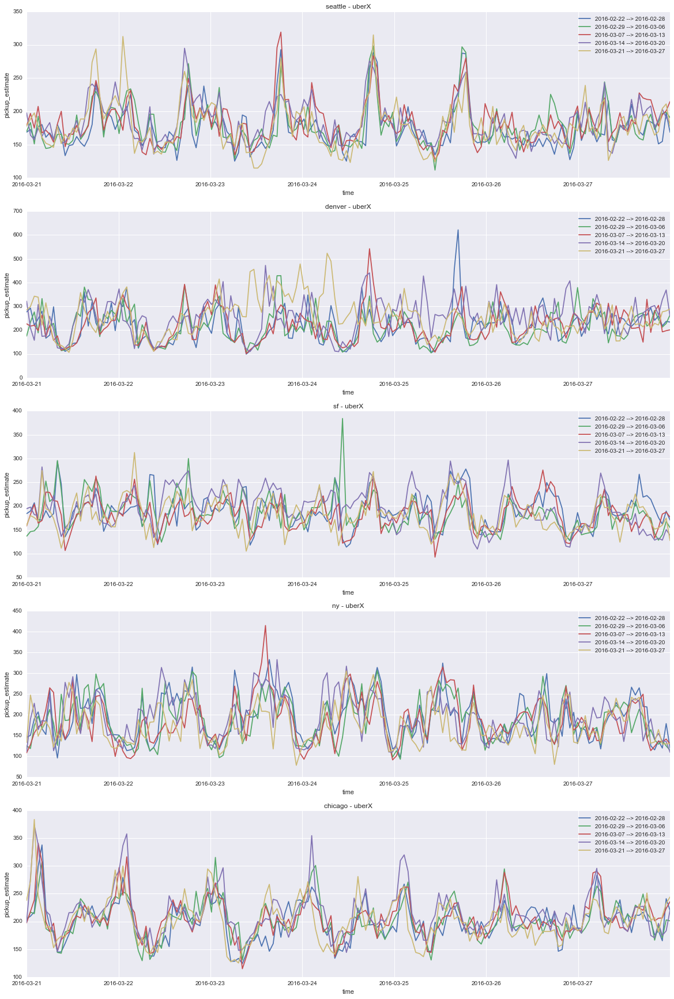

In [801]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['pickup_estimate'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('pickup_estimate')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))

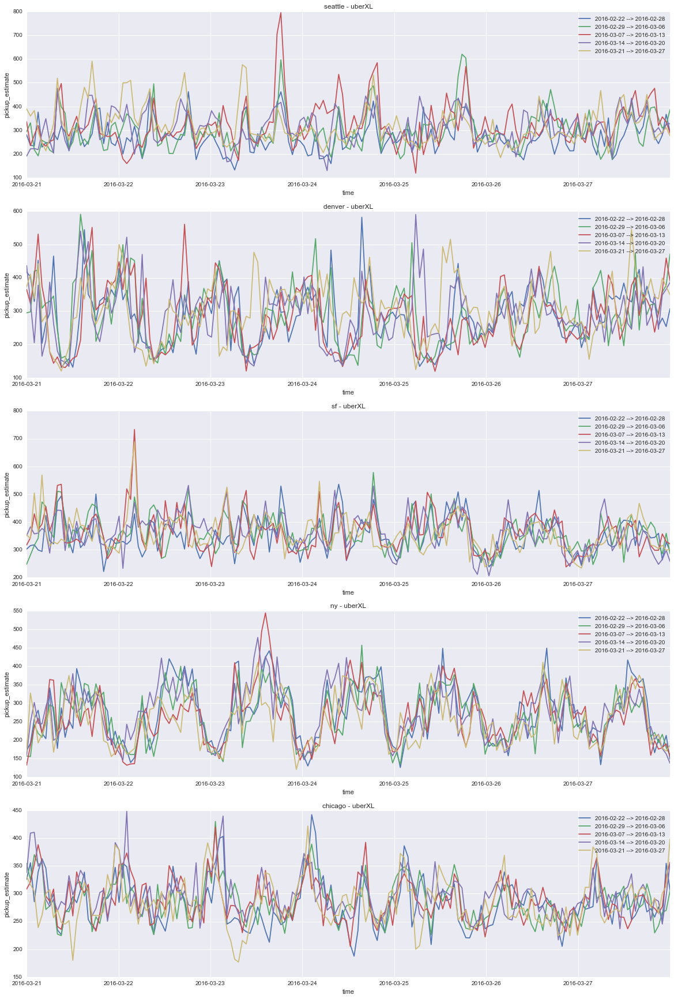

In [802]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[1]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['pickup_estimate'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('pickup_estimate')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[1]))

In [7]:
df.columns

Index([u'city', u'display_name', u'price_estimate', u'low_estimate',
       u'avg_price_est', u'high_estimate', u'trip_duration', u'trip_distance',
       u'surge_multiplier', u'surge_minimum_price', u'pickup_estimate',
       u'capacity', u'base_price', u'base_minimum_price', u'cost_per_minute',
       u'cost_per_distance', u'distance_unit', u'cancellation_fee',
       u'currency_code', u'service_fees', u'service_fees_type', u'image',
       u'description', u'start_latitude', u'start_longitude', u'stop_latitude',
       u'stop_longitude', u'start_address', u'stop_address', u'product_id',
       u'hour', u'day', u'date', u'dayofweek', u'weekofyear'],
      dtype='object')

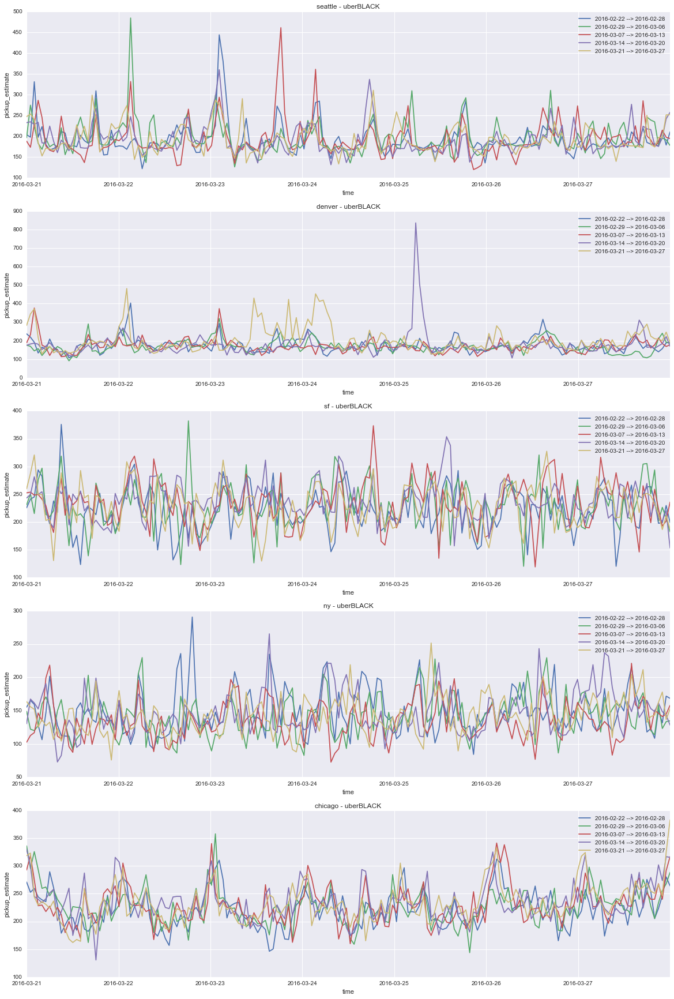

In [803]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[2]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['pickup_estimate'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('pickup_estimate')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[2]))

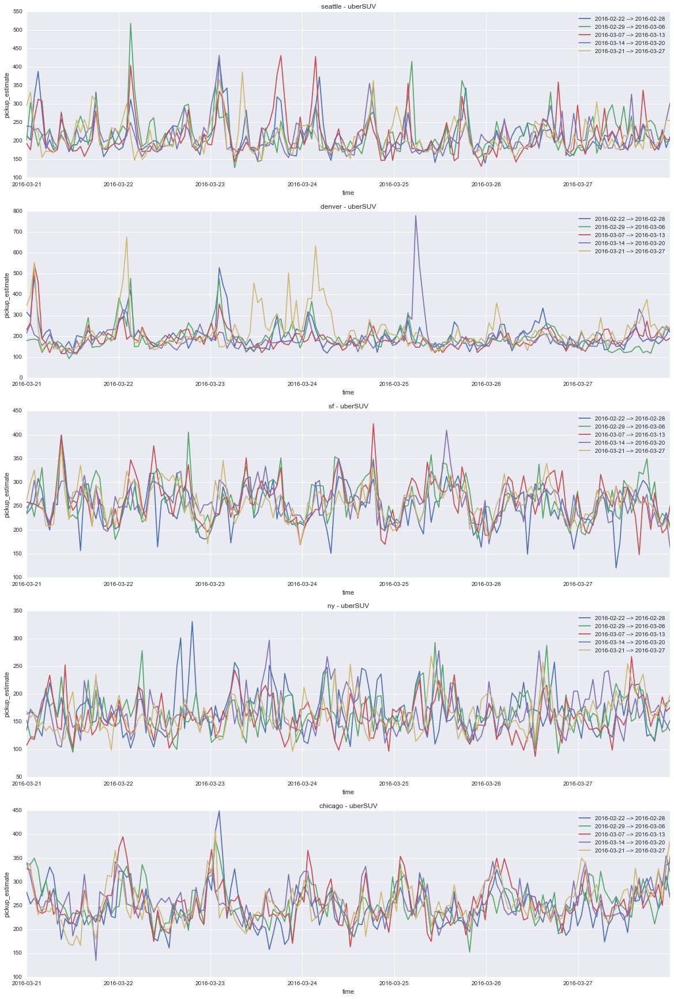

In [804]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[3]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['pickup_estimate'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('pickup_estimate')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[3]))

In [805]:
df.columns

Index([u'city', u'display_name', u'price_estimate', u'low_estimate',
       u'avg_price_est', u'high_estimate', u'trip_duration', u'trip_distance',
       u'surge_multiplier', u'surge_minimum_price', u'pickup_estimate',
       u'capacity', u'base_price', u'base_minimum_price', u'cost_per_minute',
       u'cost_per_distance', u'distance_unit', u'cancellation_fee',
       u'currency_code', u'service_fees', u'service_fees_type', u'image',
       u'description', u'start_latitude', u'start_longitude', u'stop_latitude',
       u'stop_longitude', u'start_address', u'stop_address', u'product_id',
       u'hour', u'day', u'date', u'dayofweek', u'weekofyear'],
      dtype='object')

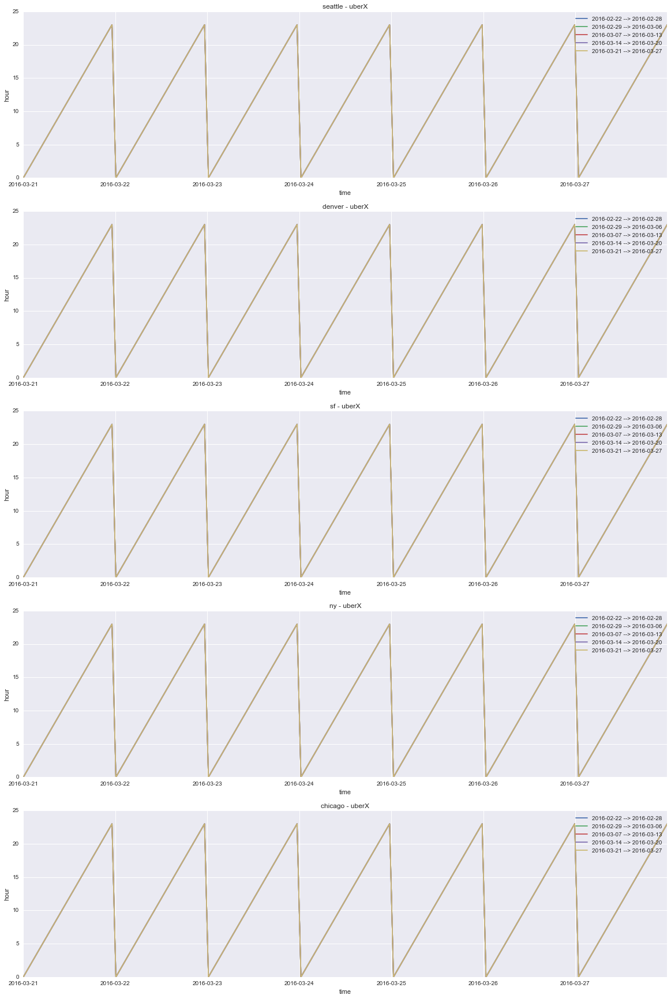

In [26]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['hour'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('hour')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))

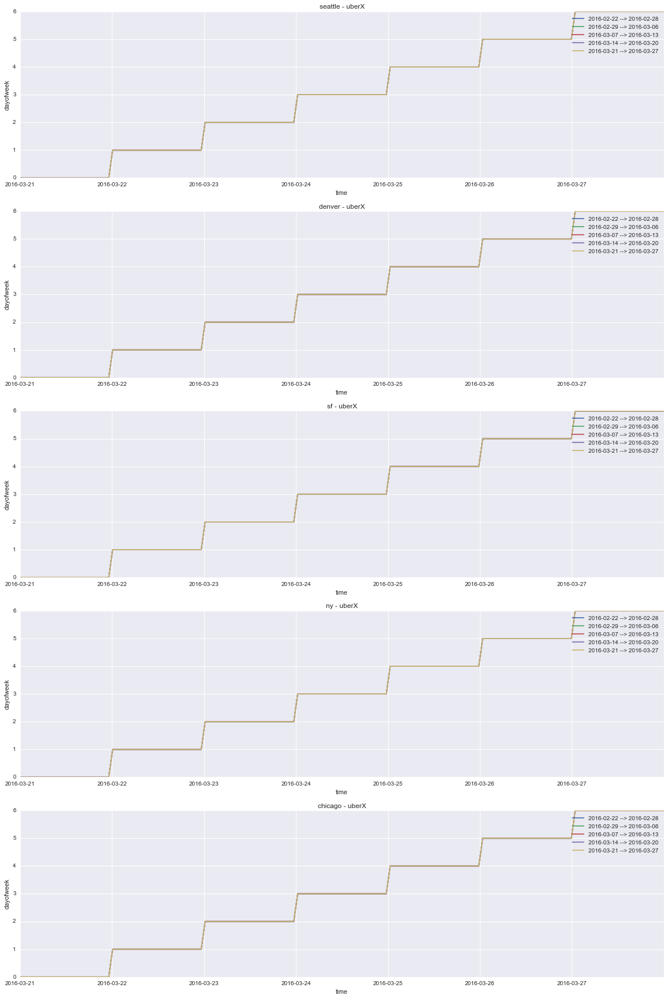

In [27]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['dayofweek'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('dayofweek')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))

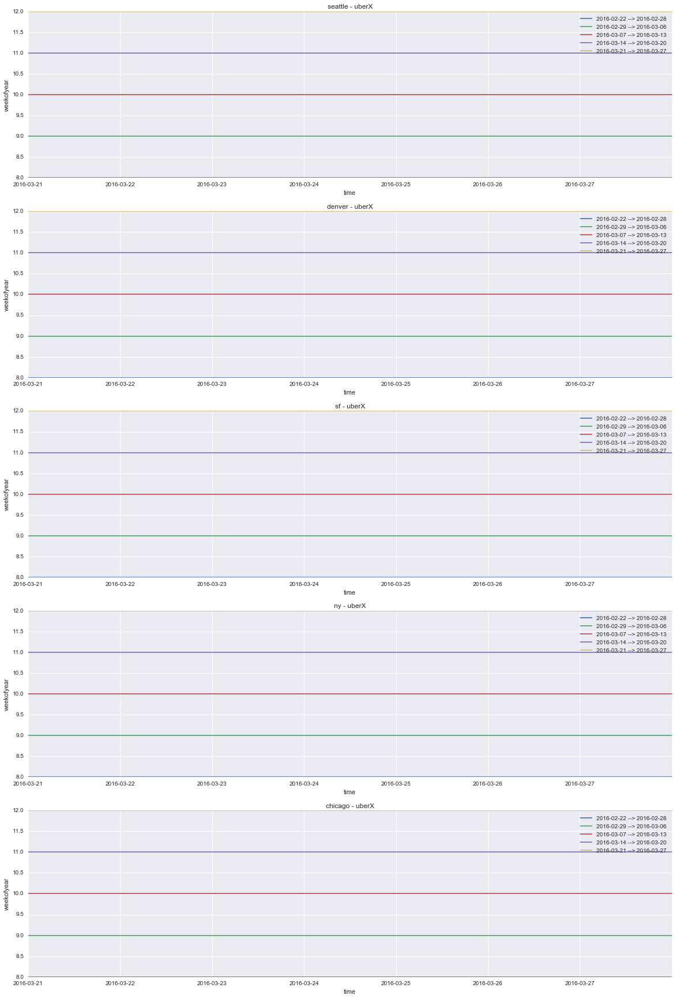

In [28]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['weekofyear'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('weekofyear')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))

[datetime.date(2016, 2, 16) datetime.date(2016, 2, 23)
 datetime.date(2016, 3, 1) datetime.date(2016, 3, 8)
 datetime.date(2016, 3, 15) datetime.date(2016, 3, 22)
 datetime.date(2016, 3, 29)]


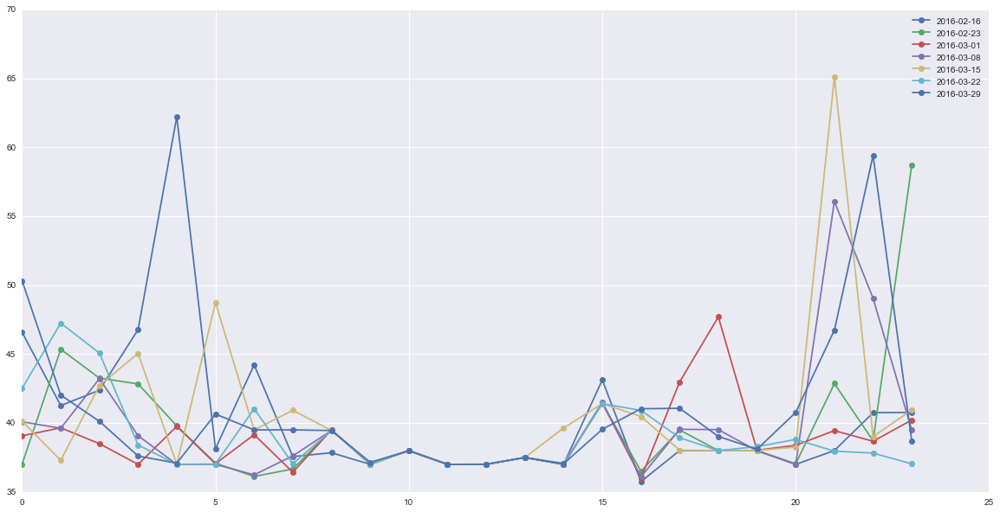

In [14]:
tues = np.unique(df.query("city == 'denver' and display_name == 'uberX' and dayofweek == 1")[['avg_price_est']].index.date)
print tues
plt.figure(figsize=(20,10))
for date in tues:
    data = df.query("city == 'denver' and display_name == 'uberX' and dayofweek == 1")[['avg_price_est']].ix[str(date)].resample('H')
    plt.plot(data.values, label=date, marker='o')
plt.legend(loc='best');

In [66]:
df['price_range'] = df['high_estimate'] - df['low_estimate']

In [67]:
df.query("city == 'denver' and display_name == 'uberX'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:41.340,37,32,42,10
2016-03-22 00:01:43.190,37,32,42,10
2016-03-22 00:02:45.890,37,32,42,10
2016-03-22 00:03:48.430,37,32,42,10
2016-03-22 00:04:51.010,37,32,42,10


In [68]:
df.query("city == 'ny' and display_name == 'uberX'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:41.310,50.5,44,57,13
2016-03-22 00:01:44.130,50.5,44,57,13
2016-03-22 00:02:46.630,50.5,44,57,13
2016-03-22 00:03:49.120,50.5,44,57,13
2016-03-22 00:04:51.840,50.5,44,57,13


In [69]:
df.query("city == 'sf' and display_name == 'uberX'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:40.780,27.5,24,31,7
2016-03-22 00:01:43.470,27.5,24,31,7
2016-03-22 00:02:46.010,27.5,24,31,7
2016-03-22 00:03:48.580,27.5,24,31,7
2016-03-22 00:04:51.200,27.5,24,31,7


In [70]:
df.query("city == 'seattle' and display_name == 'uberX'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:40.750,24.5,21,28,7
2016-03-22 00:01:43.710,24.5,21,28,7
2016-03-22 00:02:46.100,24.5,21,28,7
2016-03-22 00:03:48.410,24.5,21,28,7
2016-03-22 00:04:51.080,24.5,21,28,7


In [71]:
df.query("city == 'chicago' and display_name == 'uberX'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:40.950,31.5,28,35,7
2016-03-22 00:01:43.400,31.5,28,35,7
2016-03-22 00:02:45.990,31.5,28,35,7
2016-03-22 00:03:48.580,31.5,28,35,7
2016-03-22 00:04:51.300,31.5,28,35,7


In [72]:
df.query("city == 'denver' and display_name == 'uberXL'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:41.340,68,59,77,18
2016-03-22 00:01:43.190,68,59,77,18
2016-03-22 00:02:45.890,68,59,77,18
2016-03-22 00:03:48.430,68,59,77,18
2016-03-22 00:05:53.680,68,59,77,18


In [74]:
df.query("city == 'seattle' and display_name == 'uberXL'").ix['2016-03-22'][['avg_price_est','low_estimate','high_estimate','price_range']].head()

,avg_price_est,low_estimate,high_estimate,price_range
record_time,,,,
2016-03-22 00:00:40.750,45.5,39,52,13
2016-03-22 00:01:43.710,45.5,39,52,13
2016-03-22 00:02:46.100,45.5,39,52,13
2016-03-22 00:03:48.410,45.5,39,52,13
2016-03-22 00:04:51.080,45.5,39,52,13


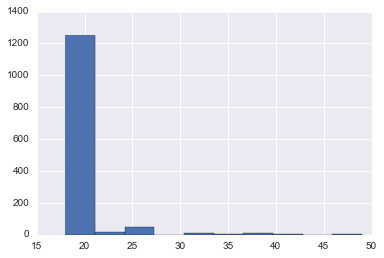

In [78]:
df.query("city == 'denver' and display_name == 'uberXL'").ix['2016-03-22']['price_range'].hist();

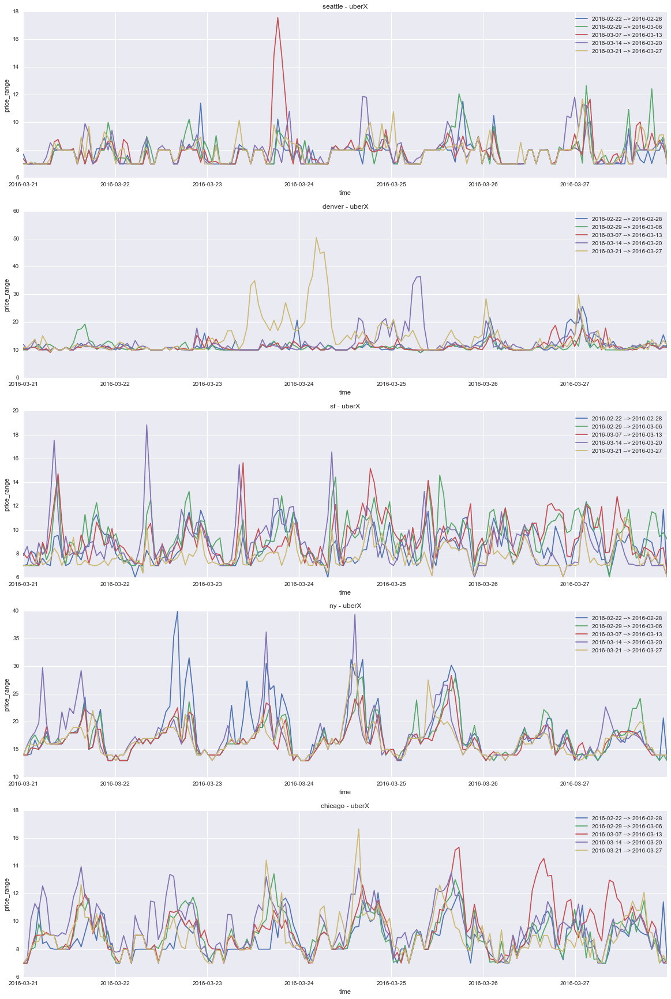

In [79]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['price_range'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('price_range')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))

In [82]:
df['price_per_range'] = df['avg_price_est'] / df['price_range'].astype(float)

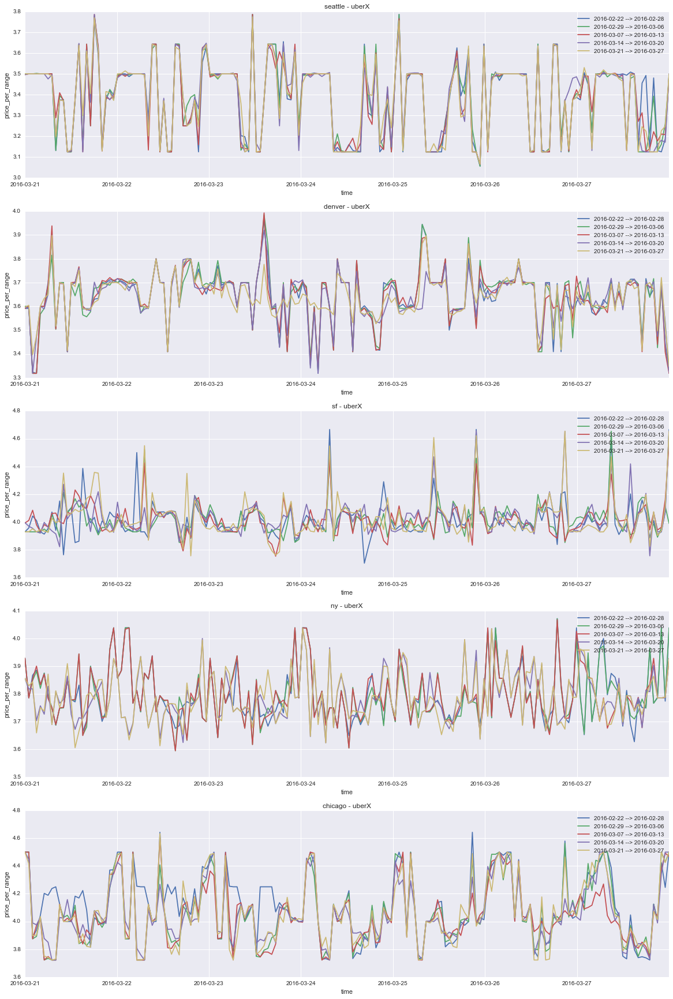

In [84]:
wkly_dates = [('2016-02-22','2016-02-28'), ('2016-02-29','2016-03-06'), 
              ('2016-03-07','2016-03-13'), ('2016-03-14','2016-03-20'),
             ('2016-03-21','2016-03-27')]
fig, ax = plt.subplots(5,1, figsize=(20,30))
for i, axs in enumerate(ax.reshape(5,)):
    for start, end in wkly_dates:
        data = df.query("city == @cities[@i] and display_name == @cartypes[0]").ix[start:end].resample('H')
        axs.plot(data.reset_index()['price_per_range'], label='{} --> {}'.format(start,end))
        dates = np.unique(data.index.date)
        axs.set_ylabel('price_per_range')
        axs.set_xlabel('time')
        start, end = axs.get_xlim()
        stepsize = end / dates.shape[0]
        axs.set_xticks(np.arange(start, end, stepsize))
        axs.set_xticklabels(dates)
        axs.legend(loc='upper right')
        axs.set_title('{} - {}'.format(cities[i], cartypes[0]))